# How Do Danes Drive?

# 1. Motivation
The main idea behind our project is summarized in this video:

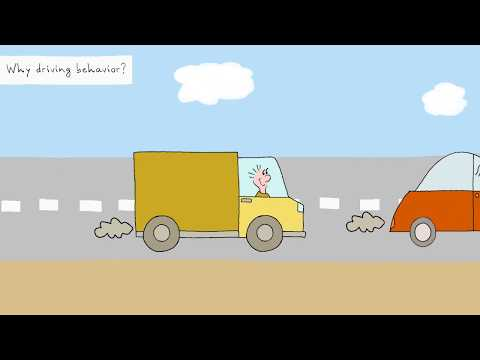

In [24]:
from IPython.display import YouTubeVideo
YouTubeVideo("LNPDZ1TbVPU",width=800,height=450)

### 1A. What is your dataset?

We chose two different data sets:
- a [traffic data set](https://www.opendata.dk/vejdirektoratet/stojdata-mastra) - containing data about traffic measurements performed in several Danish roads
- a [socioeconomic data set](http://noegletal.dk/noegletal/) - containing data about socioeconomic indicators in Danish municipalities

### 1B. Why did you choose this/these particular dataset(s)?

We chose these datasets because of their interesting nature. In Denmark:
- there are 2.5 million cars, about one in every two people, and 42600 trucks
- commuters spend 146 hours per week driving to work
- traffic delays cost Denmark 20 billion DKK every year

Driving has a considerable impact on the lives of Danes and on the Danish cities. Furthemore, investigating the driving behavior of a population might shed light on its underlying traits and on geographical differences. Therefore, it would be interesting to explore the driving behavior of Danes, visualize geographic patterns and explain the variation among municipalities.

More specifically, the traffic data set contains interesting information about the driving behaviour of people (e.g. average speed, percentage of people driving above the speed limit), and about the road where the measurment is performed (e.g. speed limit, longitude and latitude, municipality). The socioeconomic data gives us the opportunity to enrich the traffic data set with information about socioeconomic factors of the Danish municipalities.


### 1C. What was your goal for the end user's experience?
We would like to enable the viewer to explore the traffic behaviour of Danes throughout the different municipalities and to investigate the relations of traffic behavior with socioeconomic variables.  


# 2. Basic stats. Let's understand the datasets better
## 2A. Traffic data set

### i. Data loading and cleaning

#### Importing packages and defining functions

Before starting, we import some packages.

In [25]:
# Load the Pandas libraries with alias 'pd' 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy
import seaborn as sns
import numpy as np
from folium import plugins
from sklearn.feature_selection import RFECV
from sklearn.model_selection import KFold
from sklearn.linear_model import LinearRegression
import pickle
from folium.plugins import HeatMap
import folium
from scipy import stats
import branca
from sklearn.neighbors import KNeighborsRegressor
import geopandas as gpd
from mpl_toolkits.axes_grid1 import make_axes_locatable
np.warnings.filterwarnings('ignore')
pd.set_option("display.max_columns", 30)

We also define some functions.

In [26]:
def pearsonr_ci(x,y,alpha=0.05):
    ''' calculate Pearson correlation along with the confidence interval using scipy and numpy
    Parameters
    ----------
    x, y : iterable object such as a list or np.array
      Input for correlation calculation
    alpha : float
      Significance level. 0.05 by default
    Returns
    -------
    r : float
      Pearson's correlation coefficient
    pval : float
      The corresponding p value
    lo, hi : float
      The lower and upper bound of confidence intervals
    '''

    r, p = stats.pearsonr(x,y)
    r_z = np.arctanh(r)
    se = 1/np.sqrt(x.size-3)
    z = stats.norm.ppf(1-alpha/2)
    lo_z, hi_z = r_z-z*se, r_z+z*se
    lo, hi = np.tanh((lo_z, hi_z))
    return r, p, lo, hi

#### Loading data

We load the traffic data set and then we inspect the variables, to have an overview of the information contained in the data set. 

Each observation corresponds to a road measurement, performed in a defined location over a number of days.

In [27]:
#Load the data
url = 'https://raw.githubusercontent.com/IncioMan/socialdata/master/FinalProject/dataset/trafficdata_withlonlat_ver2.csv'
traffic_data = pd.read_csv(url, error_bad_lines=False)
#Format the Latitude variable
traffic_data.Latitude = traffic_data.Latitude.str.replace(";", "")
traffic_data.head()

,FID,Dataowner,RoadManager,RoadId,RoadPartId,RoadName,Kilometer,Meter,Location,Municipality,TypeOfVehicle,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,...,AverageSpeed,CountedDays,AE10High,AE10Low,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Coordinates,Longitude,Latitude
0,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,751,751.0,7511252,0,Christian X´s Vej,0.0,540.0,Ml. Ellehammervej og Marconivej,751.0,MOTORKTJ,2017.0,5526.0,6495.0,4516.0,...,NaN,7.0,NaN,NaN,NaN,50.0,NaN,NaN,NaN,NaN,NaN,NaN,POINT (573014.0000013472 6221529.999744055),10.174776,56.133225937782534
1,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,851,851.0,8515246,0,Marathonvej,0.0,180.0,Fabriksparken / Hobrovej,851.0,MOTORKTJ,2016.0,1151.0,1337.0,967.0,...,44.4,8.3,14.0,6.0,38.0,50.0,34.8,53.9,27.1,3.7,0.4,3.3,POINT (551965.0000006577 6315761.999742397),9.855032,56.982481704333544
2,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,851,851.0,8516178,0,Offenbachsvej,0.0,222.0,Mozartsvej / Telemannsvænget,851.0,MOTORKTJ,2016.0,386.0,483.0,325.0,...,34.9,14.2,3.0,1.0,7.0,50.0,27.1,42.3,1.4,0.1,0.0,1.7,POINT (549415.0000006119 6318575.999742349),9.813631,57.008038318905875
3,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


These are the 31 variables contained in the data set, together with a brief description to better understand them:

| Variable name | Variable description |
|---------------------|:--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| `FID` | Unique ID of the road measurement. |
| `Dataowner` | The owner of the traffic key figures - is displayed as the municipality number. The Road Directorate stands as data owner 0. |
| `RoadManager` | The road manager at the counting point - is displayed as the municipality number. The Road Directorate stands as road manager 0. |
| `RoadId` | The administrative road number as stated by CVF (see [CVF's website](https://www.vejdirektoratet.dk/side/den-centrale-vej-og-stifortegnelse-cvf)). |
| `RoadPartId` | The road section of the measurement point, in some municipalities also referred to as the Side Road Number. It is generally '0', or starts with '0', for regular road. |
| `RoadName` | The name of the road at the measurement point. |
| `Kilometer` | The distance in kilometers, which is typically the distance from the start of the road to the measurement point.|
| `Meter` | As above, it is just a meter part of the distance. |
| `Location` | Description of the measurement location. |
| `Municipality` | The municipality number at the measurement point. |
| `TypeOfVehicle` | Vehicle type, either motor vehicles (MOTORCTJ) or bicycle moped (C/K). |
| `Year` | The year in which the measurement, or measurements, were performed. |
| `AverageDailyVehicles` | Figures for annual traffic. Average number of vehicles per 24hour, taken over all days of the year. |
| `AverageWeekdayDailyVehicles` | Figures for everyday traffic. Average number of vehicles per 24hour taken over all weekdays of the year. Weekends, summer vacation period and holidays are excluded. |
| `DailyJulyTraffic` | Figures for July traffi. Average traffic on a day in July. |
| `Traffictype` | The type of traffic, which says something about the distribution of traffic over the year. |
| `AverageSpeed` | The average measured speed of the measurement point. |
| `CountedDays` | Number of days measured within the year. |
| `AE10High` | Equivalent 10-ton axes, a measure of the load of the road's bearing layer, calculated here for roads outside a designated urban area. |
| `AE10Low` | Like AE10High, but in an urban area. |
| `AverageDailyTrucks` | Average number of vehicles with a total length of more than 5.80 meters. |
| `SpeedLimit` | The speed limit applicable at the measurement point. |
| `Quantile15` | 15% speed quantile - the speed at which 15% of vehicles drive. |
| `Quantile85` | 85% speed quantile - the speed at which 85% of vehicles drive. |
| `PctOverSpeedLimit` | Percentage of vehicles traveling above the speed limit, i.e. "too fast". |
| `PctOverSpeedLimit10` | Percentage of vehicles traveling above the speed limit + 10km / h (e.g. if the speed limit is 60km/h, that is the percentage of vehicles that drive above 70km/h.) |
| `PctOverSpeedLimit20` | Percentage of vehicles traveling above the speed limit + 20km / h (e.g. if the speed limit is 60km/h, that is the percentage of vehicles that drive above 80km/h.) |
| `PctOfTrucks`| Percentage of trucks taken in relation to the total amount of motor vehicles. Trucks here are vehicles with a total length of more than 5.80 meters. |
| `Coordinates` | Coordinates of the measurement point. |  
| `Longitude` | Longitude at the measurement point. | 
| `Latitude` | Latitude at the measurement point. | 

We then inspect the shape of the data set and the types of variables. The data set originally contains 26917 observations and 31 variables. The variables are of the type object or float64.

In [28]:
traffic_data.shape

(26917, 31)

In [29]:
traffic_data.dtypes

FID                             object
Dataowner                       object
RoadManager                    float64
RoadId                          object
RoadPartId                      object
RoadName                        object
Kilometer                      float64
Meter                          float64
Location                        object
Municipality                   float64
TypeOfVehicle                   object
Year                           float64
AverageDailyVehicles           float64
AverageWeekdayDailyVehicles    float64
DailyJulyTraffic               float64
Traffictype                     object
AverageSpeed                   float64
CountedDays                    float64
AE10High                       float64
AE10Low                        float64
AverageDailyTrucks             float64
SpeedLimit                      object
Quantile15                     float64
Quantile85                      object
PctOverSpeedLimit              float64
PctOverSpeedLimit10      

We check that the FID variable is a unique ID for each observation.

In [30]:
traffic_data.FID.unique().size

26917

#### Addressing missing values

In order to address the missing values, we firstly count, for each variable, the number of rows containing NaN values.

In [31]:
traffic_data.isna().sum()

FID                                0
Dataowner                       3082
RoadManager                     3082
RoadId                          3082
RoadPartId                      3082
RoadName                        3082
Kilometer                       3082
Meter                           3082
Location                        3093
Municipality                    3082
TypeOfVehicle                   3082
Year                            3082
AverageDailyVehicles            3083
AverageWeekdayDailyVehicles     3108
DailyJulyTraffic                3082
Traffictype                     3082
AverageSpeed                    6615
CountedDays                     3082
AE10High                        9374
AE10Low                        11833
AverageDailyTrucks              9374
SpeedLimit                      5321
Quantile15                      8142
Quantile85                      8142
PctOverSpeedLimit               8254
PctOverSpeedLimit10             8254
PctOverSpeedLimit20             8254
P

For many variables, the same number of rows (3082) contains `NaN` values. Thus, we suspect that the same observations might contain missing values in more than one variable.

We remove the 3082 observations that contain `NaN` values in the `Municipality` variable. Indeed, knowing which `Municipality` the road belongs to is crucial for our analysis.

In [32]:
traffic_data = traffic_data.dropna(subset=['Municipality']).reset_index(drop=True)
traffic_data.isna().sum()

FID                               0
Dataowner                         0
RoadManager                       0
RoadId                            0
RoadPartId                        0
RoadName                          0
Kilometer                         0
Meter                             0
Location                         11
Municipality                      0
TypeOfVehicle                     0
Year                              0
AverageDailyVehicles              1
AverageWeekdayDailyVehicles      26
DailyJulyTraffic                  0
Traffictype                       0
AverageSpeed                   3533
CountedDays                       0
AE10High                       6292
AE10Low                        8751
AverageDailyTrucks             6292
SpeedLimit                     2239
Quantile15                     5060
Quantile85                     5060
PctOverSpeedLimit              5172
PctOverSpeedLimit10            5172
PctOverSpeedLimit20            5172
PctOfTrucks                 

As suspected, many rows contained `Nan` values for many variables, as there is an overall reduction of missing values when simply removing the observations that do not contain `Municipality` information. 

However, there are still `NaN` values present in the data. We choose to remove the `AE10High` and `AE10Low` variables as these are not interesting for this project. Additionally the rows containing `NaN` values for the remaining variables are removed from the data set.

In [33]:
traffic_data = traffic_data.drop(columns=["AE10Low", "AE10High"])
traffic_data = traffic_data.dropna().reset_index(drop=True)

In [34]:
len(traffic_data)

16220

After removing the missing values for the relevant variables, the data set contains 16220 observations.

For later convenience, we transform some variables into float or integers.

In [35]:
#Transforming object variables into float or integers
traffic_data['Quantile85']= pd.to_numeric(traffic_data['Quantile85'], errors='coerce')
traffic_data['SpeedLimit'] = pd.to_numeric(traffic_data['SpeedLimit'], downcast='integer', errors='coerce')

#Transforming float variables into integers
traffic_data['Year'] = pd.to_numeric(traffic_data['Year'], downcast='integer', errors='coerce')

#### Addressing outliers and errors

After addressing the missing values, we inspect the variables in order to identify possible errors, noise in the data or outliers.

##### Municipality variable
We firstly inspect the values for the `Municipality` variable. Denmark counts [98 Danish Municipalities](http://www.maerkdinbygning.dk/materiale/files/materiale-konsulenter/energimarkning/1507-nyeoggamlekommunenumre.pdf), so that should be the maximum number of unique Municipality codes.

In [36]:
#Count number of unique Municipality codes
traffic_data.Municipality.unique().size

99

The data set contains 99 Municipality codes. We make sure to remove the observations that have an unexsisting municipality code. 

To do so, we create a dictionary that maps each of the 98 Municipality codes to the corresponding Municipality name. We count the number of observations with unexsisting municipality code and realize that only 64 observations have that problem. Therefore, we safely remove them.


In [37]:
#Create dictionary
municipality_code = [101,147,151,153,155,157,159,161,163,165,167,169,173,175,183,185,187,190,201,210,217,219,223,230,240,250,253,259,260,265,269,270,306,316,320,326,329,330,336,340,350,360,370,376,390,400,410,420,430,440,450,461,479,480,482,492,510,530,540,550,561,563,573,575,580,607,615,621,630,657,661,665,671,706,707,710,727,730,740,741,746,751,756,760,766,773,779,787,791,810,813,820,825,840,846,849,851,860]
municipality_name = ["København","Frederiksberg","Ballerup","Brøndby","Dragør","Gentofte","Gladsaxe","Glostrup","Herlev","Albertslund","Hvidovre","Høje-Taastrup","Lyngby-Taarbæk","Rødovre","Ishøj","Tårnby","Vallensbæk","Furesø","Allerød","Fredensborg","Helsingør","Hillerød","Hørsholm","Rudersdal","Egedal","Frederikssund","Greve","Køge","Halsnæs","Roskilde","Solrød","Gribskov","Odsherred","Holbæk","Faxe","Kalundborg","Ringsted","Slagelse","Stevns","Sorø","Lejre","Lolland","Næstved","Guldborgsund","Vordingborg","Bornholm","Middelfart","Assens","Faaborg-Midtfyn","Kerteminde","Nyborg","Odense","Svendborg","Nordfyns","Langeland","Ærø","Haderslev","Billund","Sønderborg","Tønder","Esbjerg","Fanø","Varde","Vejen","Aabenraa","Fredericia","Horsens","Kolding","Vejle","Herning","Holstebro","Lemvig","Struer","Syddjurs","Norddjurs","Favrskov","Odder","Randers","Silkeborg","Samsø","Skanderborg","Aarhus","Ikast-Brande","Ringkøbing-Skjern","Hedensted","Morsø","Skive","Thisted","Viborg","Brønderslev","Frederikshavn","Vesthimmerlands","Læsø","Rebild","Mariagerfjord","Jammerbugt","Aalborg","Hjørring"]

municipality_dictionary = dict(zip(municipality_name, municipality_code))
inverse_dictionary = dict(zip(municipality_code, municipality_name))

In [38]:
#Count the observations with unexisting municipality codes
wrong_municipality_code = traffic_data[~traffic_data.Municipality.isin(municipality_dictionary.values())]
len(wrong_municipality_code)

64

In [39]:
#Remove observations with unexisting municipality code
traffic_data = traffic_data[traffic_data.Municipality.isin(municipality_dictionary.values())]
traffic_data.reset_index(drop=True)

,FID,Dataowner,RoadManager,RoadId,RoadPartId,RoadName,Kilometer,Meter,Location,Municipality,TypeOfVehicle,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,Traffictype,AverageSpeed,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Coordinates,Longitude,Latitude
0,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,851,851.0,8515246,0,Marathonvej,0.0,180.0,Fabriksparken / Hobrovej,851.0,MOTORKTJ,2016,1151.0,1337.0,967.0,BO-ARB,44.4,8.3,38.0,50,34.8,53.9,27.1,3.7,0.4,3.3,POINT (551965.0000006577 6315761.999742397),9.855032,56.982481704333544
1,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,851,851.0,8516178,0,Offenbachsvej,0.0,222.0,Mozartsvej / Telemannsvænget,851.0,MOTORKTJ,2016,386.0,483.0,325.0,BO-ARB,34.9,14.2,7.0,50,27.1,42.3,1.4,0.1,0.0,1.7,POINT (549415.0000006119 6318575.999742349),9.813631,57.008038318905875
2,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,0,0.0,2098092,0,Strandvangen,2.0,110.0,Haldor Topsøe Park sidevejstælling til vej 522,250.0,MOTORKTJ,2017,1531.0,1754.0,1251.0,BO-ARB,61.5,11.0,51.0,50,50.6,71.7,86.6,51.6,18.1,3.3,POINT (694577.0004696539 6191030.999748546),12.106416,55.82555241047242
3,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,316,316.0,300602,0,Slagelse-Snertinge,26.0,640.0,Ved Bromøllekro,316.0,MOTORKTJ,2019,4765.0,5156.0,4972.0,REGIONAL,59.0,11.3,268.0,60,45.9,71.1,52.3,16.9,3.4,5.6,POINT (650362.0000756377 6165480.999744786),11.387280,55.611970825163425
4,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,756,756.0,653610,0,Nordlundvej,1.0,801.0,Brande,756.0,MOTORKTJ,2015,540.0,600.0,454.0,BO-ARB,65.6,7.1,36.0,80,48.1,79.5,13.9,3.5,0.9,6.6,POINT (505954.00000006706 6200889.999744435),9.095351,55.95332579787799
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16151,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,550,550.0,5319799,0,Skærbækvej,12.0,70.0,Arrild,550.0,MOTORKTJ,2014,868.0,999.0,731.0,BO-ARB,51.5,7.9,106.0,50,36.9,64.4,57.0,24.7,7.1,12.2,POINT (497199.99999996857 6111558.999746101),8.956048,55.15066174409621
16152,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,710,710.0,7093538,0,Hovhedevej,0.0,233.0,Lygtepaelnr23Slange,710.0,MOTORKTJ,2018,277.0,295.0,228.0,BO-ARB,46.6,7.7,27.0,50,35.4,57.4,40.7,8.7,1.1,9.8,POINT (562929.0000009086 6247036.999743606),10.018608,56.36379564979153
16153,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,550,550.0,500501,0,Bov - Toftlund - Spandet(Sted-id:50156908),51.0,653.0,Toftlund,550.0,MOTORKTJ,2018,3691.0,3898.0,3846.0,REGIONAL,85.7,15.8,493.0,80,74.4,97.1,72.3,27.9,9.8,13.4,POINT (503235.0000000356 6117045.999745996),9.050825,55.199966145397205
16154,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,791,791.0,7910394,0,Asmildhøjen (8800),0.0,195.0,Viborg,791.0,MOTORKTJ,2020,751.0,799.0,680.0,BY,47.3,7.0,6.0,50,38.8,55.9,36.4,6.0,0.4,0.9,POINT (526633.0000003047 6256548.999743435),9.432097,56.45268716667381


In [40]:
#Create a MunicipalityName variable
traffic_data['MunicipalityName'] = traffic_data.Municipality.map(inverse_dictionary)

##### Removing Municipalities with few observations
Since our analysis is focused on investigating the differences in the driving behaviour among the Danish Municipalities, we will later group the road measurement by Municipality. However, we only want to consider the Municipality that have a sufficient number of observations. Thereore, we count the number of observations per Municipality.

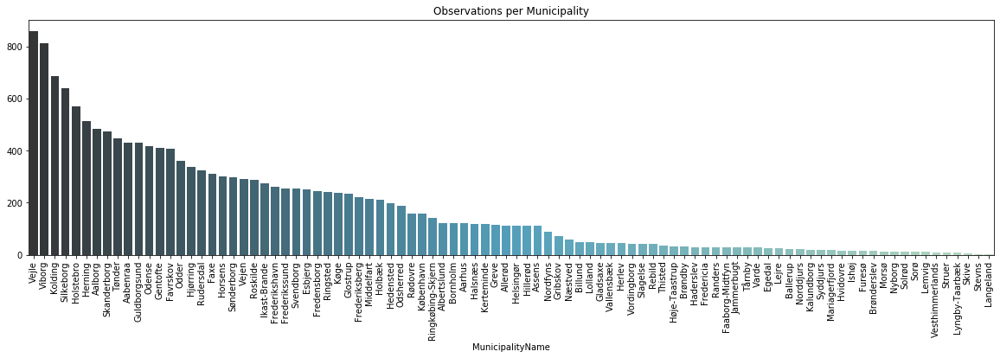

In [41]:
#Plot the number of observations per Municipality
plt.figure(figsize=(20,5))
plt.title("Observations per Municipality")
df = traffic_data.groupby('MunicipalityName').FID.count().sort_values(ascending = False)
ax = sns.barplot(df.keys(), df.values, order=df.keys(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

It can be seen that the number of roads measured varies in the different Municipalities and that some Municipalities have very few observations. Since a small number of road measurements might not be representative of the Municipality, we remove the Municipalities that have less then 30 road measurements (i.e. observations).

In [42]:
#Remove the municipalities that have less then 30 observations
obsmunicipalities = traffic_data.groupby('MunicipalityName').FID.count().sort_values(ascending = False)
selectedmunicipalities = list(obsmunicipalities[obsmunicipalities>30].index)
traffic_data = traffic_data[traffic_data.MunicipalityName.isin(selectedmunicipalities)]

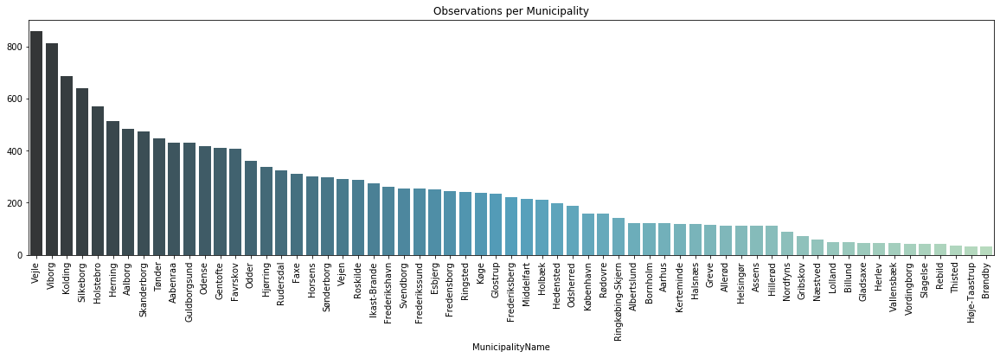

In [43]:
#Plot the number of observations per Selected municipalities
plt.figure(figsize=(20,5))
plt.title("Observations per Municipality")
df = traffic_data.groupby('MunicipalityName').FID.count().sort_values(ascending = False)
ax = sns.barplot(df.keys(), df.values, order=df.keys(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

In [44]:
len(traffic_data.MunicipalityName.unique())

63

We are left with 63 Municipality which have more than 30 observations. These are the ones we will work with.

##### Other variables
We then explore the other variables, by displaying the  summary statistics and investigating potential erros.

In [45]:
traffic_data.describe()

,RoadManager,Kilometer,Meter,Municipality,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,AverageSpeed,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Longitude
count,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000
mean,469.304095,8.850955,379.577333,526.302434,2016.697758,3778.110905,4186.496838,3545.200473,50.861100,16.456398,328.870504,61.455057,40.816738,60.506210,25.526953,7.871590,2.261675,7.664422,10.450671
std,268.772851,30.361906,281.610034,221.825670,2.810015,8607.585843,9452.833043,8567.165523,19.354803,26.259204,1042.094475,20.141757,17.731612,21.311722,25.385860,12.092178,5.441748,5.865497,1.370574
min,0.000000,0.000000,0.000000,101.000000,2000.000000,0.000000,0.000000,0.000000,8.200000,1.300000,-74.000000,15.000000,6.600000,9.500000,0.000000,-7.700000,-17.200000,-3.100000,8.114568
25%,230.000000,0.000000,140.000000,320.000000,2015.000000,479.000000,528.000000,419.000000,37.300000,7.000000,26.000000,50.000000,27.600000,46.000000,2.400000,0.300000,0.100000,3.900000,9.437380
50%,550.000000,0.000000,313.000000,580.000000,2017.000000,1349.000000,1500.000000,1203.000000,48.000000,7.900000,83.000000,50.000000,38.800000,56.900000,17.600000,2.700000,0.500000,6.700000,9.947871
75%,710.000000,3.000000,600.000000,727.000000,2019.000000,3829.000000,4287.000000,3439.000000,61.300000,10.700000,261.000000,80.000000,49.400000,72.800000,43.500000,10.700000,2.200000,9.900000,11.950020
max,860.000000,342.000000,3300.000000,860.000000,2020.000000,134915.000000,144973.000000,138913.000000,120.500000,365.800000,29273.000000,801.000000,102.400000,137.700000,99.500000,98.200000,93.400000,115.900000,15.149853


Below are some key takeaways from the summary statistics, which require further investigation:
* `Kilometer:` The maximum distance is 645, indicating that there is a measuring station 645 kilometers from the start of the road. This number is very high as roads in Denmark are not this long.
* `AverageDailyVehicles:` The minimum value for the average daily number of vehicles is negative, which should not be possible. The same is the case for `AverageWeekdayDailyVehicles`, `DailyJulyTraffic`, `PctOverSpeedLimit`, `PctOverSpeedLimit10`, `PctOverSpeedLimit20` and `PctOfTrucks`.
* `PctOfTrucks:` The maximum value for the percentage of trucks on a road exceeds 100 % which should not be possible.
* `AverageWeekdayDailyVehicles:` Some values for the average weekday number of vehicles are very high, but when compared to statistics from [vejdirektoratet.dk](https://www.vejdirektoratet.dk/side/trafikkens-udvikling-i-tal), it is in accordance with the most populated roads in Denmark (Køge Bugt Motorvejen, Motorring 3).
* `SpeedLimit:` The maximum value is 801, which is indeed an odd speed limit.

Let's have a deeper look into some of these suspicious measurements. Let's look at the 645 km long road.

In [46]:
traffic_data[traffic_data["Kilometer"] == traffic_data["Kilometer"].max()]

,FID,Dataowner,RoadManager,RoadId,RoadPartId,RoadName,Kilometer,Meter,Location,Municipality,TypeOfVehicle,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,Traffictype,AverageSpeed,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Coordinates,Longitude,Latitude,MunicipalityName
15339,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,80,12,Frederikshavnmotorvejen,342.0,270.0,Sideanlæg: Øksenhede Vest,813.0,MOTORKTJ,2016,161.0,163.0,234.0,UDPR FERIE,58.9,13.6,17.0,130,42.0,84.4,0.6,-2.5,-5.7,10.3,POINT (587721.0000033564 6357194.99974163),10.457762,57.34916415365037,Frederikshavn


A quick google search indicates that Frederikshavnmotorvejen is indeed not 645 kilometers. The longest road in Denmark is 310 kilometers, and it is the E45 high-speed road (Ref: https://da.wikipedia.org/wiki/Motorveje_i_Danmark). Let's see how many roads exceed this number in the data set.

In [47]:
print("Amount of measurements stations placed more than 310 kilometers away from start of road: {}".format(sum(traffic_data["Kilometer"] > 310)))

Amount of measurements stations placed more than 310 kilometers away from start of road: 8


It is hard to say if these roads are faulty measurements as the `Kilometer` variable is defined as "the distance in kilometers, which is _typically_ the distance from the start of the road to the measurement point".

We therefore choose to keep the observations with high values for Kilometer in further analysis.

Below are counts for:
- negative observations for the variables that shouldn't contain negative values
- observations exceeding 100% in `PctOfTrucks` are also shown
- observations with `SpeedLimit` higher than 130 are also counted.

In [48]:
print("Amount of negative observations in AverageDailyVehicles columns: {}".format(sum(traffic_data["AverageDailyVehicles"] < 0)))
print("Amount of negative observations in AverageWeekdayDailyVehicles columns: {}".format(sum(traffic_data["AverageWeekdayDailyVehicles"] < 0)))
print("Amount of negative observations in DailyJulyTraffic columns: {}".format(sum(traffic_data["DailyJulyTraffic"] < 0)))
print("Amount of negative observations in AverageDailyTrucks columns: {}".format(sum(traffic_data["AverageDailyTrucks"] < 0)))
print("Amount of negative observations in PctOverSpeedLimit10 columns: {}".format(sum(traffic_data["PctOverSpeedLimit10"] < 0)))
print("Amount of negative observations in PctOverSpeedLimit20 columns: {}".format(sum(traffic_data["PctOverSpeedLimit20"] < 0)))
print("Amount of negative observations in PctOfTrucks columns: {}".format(sum(traffic_data["PctOfTrucks"] < 0)))
print("Amount of observations exceeding 100 % PctOfTrucks columns: {}".format(sum(traffic_data["PctOfTrucks"] > 100)))
print("Amount of observations exceeding a speeding limit of 130: {}".format(sum(traffic_data["SpeedLimit"] > 130)))

Amount of negative observations in AverageDailyVehicles columns: 0
Amount of negative observations in AverageWeekdayDailyVehicles columns: 0
Amount of negative observations in DailyJulyTraffic columns: 0
Amount of negative observations in AverageDailyTrucks columns: 1
Amount of negative observations in PctOverSpeedLimit10 columns: 17
Amount of negative observations in PctOverSpeedLimit20 columns: 25
Amount of negative observations in PctOfTrucks columns: 1
Amount of observations exceeding 100 % PctOfTrucks columns: 1
Amount of observations exceeding a speeding limit of 130: 1


The majority of observations are positive, with only a few negative ones. The observations are replaced with NaN values.

In [49]:
num = traffic_data._get_numeric_data()
num[num < 0] = np.nan
if traffic_data.PctOfTrucks.max() > 100:
    traffic_data.PctOfTrucks.replace([traffic_data.PctOfTrucks.max()], np.nan, inplace = True)
if traffic_data.SpeedLimit.max() > 130:
    traffic_data.SpeedLimit.replace([traffic_data.SpeedLimit.max()], np.nan, inplace = True)

##### Number of observations per Year

We then investigate how the observations are distributed throughout the different years.

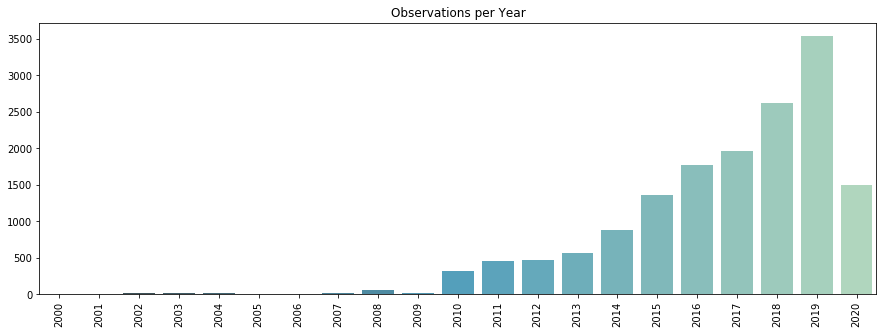

In [50]:
#Plot the number of observations per year
plt.figure(figsize=(15,5))
plt.title("Observations per Year")
df = traffic_data.Year.value_counts()
ax = sns.barplot(df.keys(), df.values, order=df.keys().sort_values(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

The years from 2000 to 2009 present very few observations and we therefore decide to focus our analysis on data collected from years from 2010 onwards.

In [51]:
#Remove observation dating before 2010
traffic_data = traffic_data[traffic_data.Year > 2009]

##### Overview of the observations

After having addressed missing values, outliers and errors, we want to get an overview of the geographical distribution of the observations contained in the clean data set. We thus display them in a map.

In [52]:
#Plot all observations
map_obs = folium.Map(location=[56.2325, 10.7922], zoom_start = 7)
for index, row in traffic_data.iterrows():
    folium.Circle([row.Latitude, row.Longitude],radius = 1, opacity = 0.2 , popup=row.Location).add_to(map_obs)
map_obs

The overview of observations location shows some blank spots which indicate areas/municipalities with no observations registered. Some of these are: *Hadersvel* and *Varde* (South of Jutland), *Ringe* (Middle of Fyn), *Sorø* (West of Sjælland). This shows that some areas of the country may need more monitoring and data measurements, and needs to be taken into consideration when formulating hypothesis from the analysis of our data. The level of opacity set to 0.2 allows to roughly identify the higher oservations density areas which matches with the presence of big cities such as _Aalborg, Roskilde, Odense_ and the _Copenhagen area_.

### ii. Data manipulation

In order to extract some meaningful information from the variables in the data set, we create two new variables. More specifically, we compute:
- `AverageDifferenceSpeedLimitAvgSpeed`: difference between the speed limit and the average speed. This is useful to assess how close to the speed limit the people drive on a specific road. Indeed, looking at the average speed alone, without considering the speed limit, provides limited information.
- `JulyWeekdaysRatio`: ratio between the number of vehicles in a day in July and the number of vehicles in a working day. This is interesting to analyse the variation in the number of vehicles in different times of the year.

In [29]:
#Create the first variable

traffic_data = traffic_data.dropna(subset=['SpeedLimit', 'AverageSpeed'])
traffic_data["AverageDifferenceSpeedLimitAvgSpeed"] =  traffic_data.SpeedLimit - traffic_data.AverageSpeed

In [30]:
#Create the second variable

#We exclude data points where AverageWeekdayDailyVehicles is 0 as to not to divide by 0 - a total of 3 observations have 0-values in AverageWeekdayDailyVehicles.
traffic_data = traffic_data[traffic_data.AverageWeekdayDailyVehicles != 0].reset_index(drop=True)
traffic_data["JulyWeekdaysRatio"] = traffic_data.DailyJulyTraffic / traffic_data.AverageWeekdayDailyVehicles

### iii. Summary statistics and variable distributions

We display the summary statistics of the clean data set and investigate the variable distribution.

In [31]:
traffic_data.describe()

,RoadManager,Kilometer,Meter,Municipality,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,AverageSpeed,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Longitude,AverageDifferenceSpeedLimitAvgSpeed,JulyWeekdaysRatio
count,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15457.000000,15458.000000,15458.000000,15458.000000,15458.000000,15441.000000,15433.000000,15456.000000,15458.000000,15458.000000,15458.000000
mean,469.721568,8.862078,379.291823,527.438931,2016.835360,3799.328503,4212.237547,3558.112887,50.822092,16.497891,330.318044,61.412537,40.803810,60.442742,25.433769,7.809552,2.240051,7.624554,10.449590,10.590445,0.818764
std,269.973528,30.500057,281.456968,222.425775,2.519844,8656.074883,9505.953067,8615.107959,19.371148,26.286268,1048.212888,19.310899,17.746424,21.323645,25.342260,11.999525,5.346207,5.802370,1.363711,13.167615,0.241416
min,0.000000,0.000000,0.000000,101.000000,2010.000000,1.000000,1.000000,0.000000,8.200000,1.300000,0.000000,15.000000,6.600000,9.500000,0.000000,0.000000,0.000000,0.000000,8.114568,-39.000000,0.000000
25%,230.000000,0.000000,140.000000,320.000000,2015.000000,479.000000,529.000000,417.000000,37.300000,7.000000,26.000000,50.000000,27.500000,45.900000,2.400000,0.300000,0.100000,3.900000,9.440153,1.400000,0.719010
50%,550.000000,0.000000,313.000000,580.000000,2017.000000,1353.000000,1503.000000,1198.000000,48.000000,7.900000,82.000000,50.000000,38.800000,56.900000,17.500000,2.700000,0.500000,6.600000,9.948360,8.600000,0.755683
75%,710.000000,3.000000,600.000000,727.000000,2019.000000,3837.750000,4297.750000,3436.750000,61.200000,10.700000,260.000000,80.000000,49.300000,72.700000,43.400000,10.600000,2.100000,9.900000,11.944586,18.000000,0.828463
max,860.000000,342.000000,3300.000000,860.000000,2020.000000,134915.000000,144973.000000,138913.000000,120.500000,365.800000,29273.000000,130.000000,102.400000,137.700000,99.500000,98.200000,93.400000,99.000000,15.149853,99.700000,5.969203


As seen from the summary statistics table, the processed data set has been reduced to contain 15652 observations. It it is noted that none of the observations are subceeding or exceeding reasonable limits for the given variable. This is of course not a guarantee that the observations are free from errors or potential outliers, but rather that the obvious ones were removed.

Having a closer look at the variables `Kilometer`, `CountedDays` and the variables denoting the number of vehicles and the percentage of vehicles driving above the speed limit, we see that their maximum values are far from the interquartile range, indicating that few observations have very large values - in other words, some few roads have very different behaviours compared to the majority of roads. This could be due to the large difference in traffic levels when comparing low capacity roads (e.g. urban streets) with highways. A potential casue for roads with a lot of speeding could be due to incorrect speed limits, or lack of transparency for the particular speed limit.

Below are histograms displaying the distribution of a subset of the variables which we find interesting.

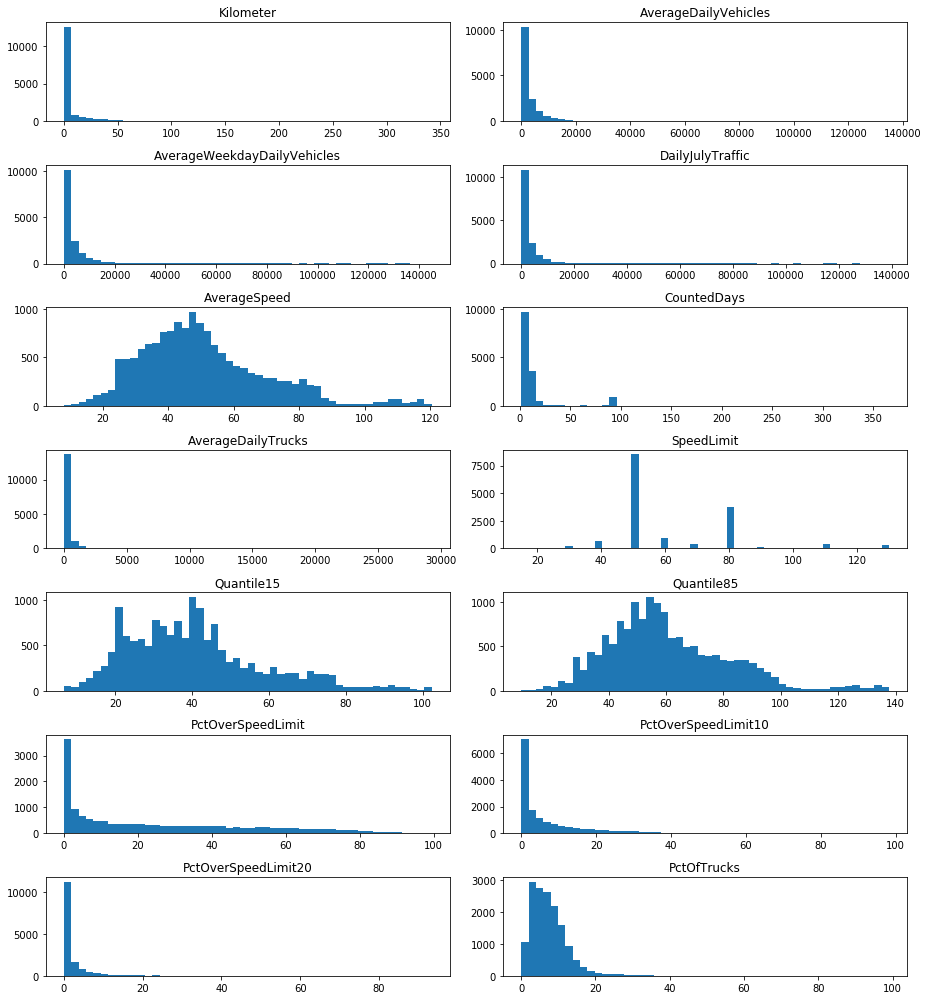

In [32]:
cols_to_plot = ['Kilometer', 'AverageDailyVehicles',
       'AverageWeekdayDailyVehicles', 'DailyJulyTraffic',
       'AverageSpeed', 'CountedDays',
       'AverageDailyTrucks', 'SpeedLimit', 'Quantile15', 'Quantile85',
       'PctOverSpeedLimit', 'PctOverSpeedLimit10', 'PctOverSpeedLimit20',
       'PctOfTrucks'] #ADD NEW VARIABLES

fig = plt.figure(figsize=(13,14))
for i in range(len(cols_to_plot)):
    fig.add_subplot(7, 2, i+1)
    plt.hist(pd.to_numeric(traffic_data[cols_to_plot[i]]), bins = 50)
    plt.title(cols_to_plot[i])
    plt.tight_layout()
    
plt.show()

As suspected by looking at the summary statistics, many of the variables are not normally distributed and have tendencies to have long tails to the right, which indicate that there are a few high valued observations. Despite these being outliers compared to the rest of the data, the values are still seen as realistic, and therefore kept in the data set for further analysis.

Only a few variables, all related to speed (`Average speed`, `Quantile15`, `Quantile85`), have a distribution that resembles the normal distribution. Indeed, it is reasonable to expect that, when considering the driving speed, a majority of people will drive at a similar speed, and a fewer percentage will drive either slower or faster (i.e. the two tails of the normal distribution).

These observations are confirmed by the Q-Q plots below.

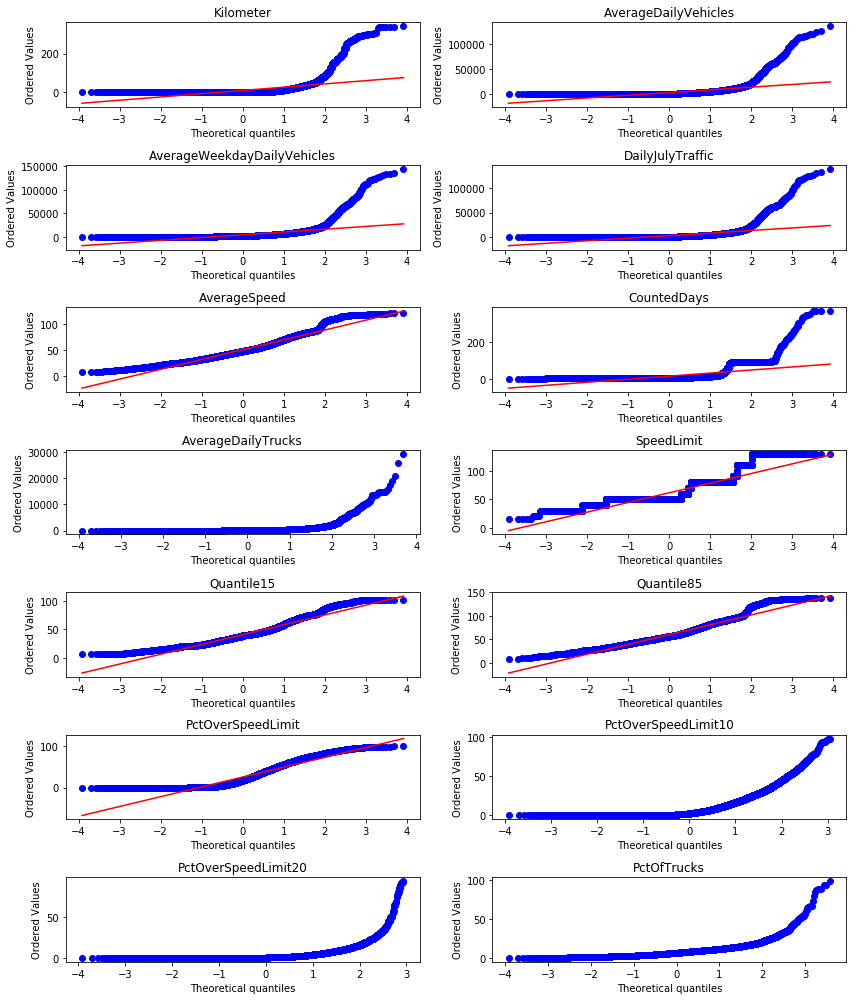

In [33]:
fig = plt.figure(figsize=(12,14))
for i in range(len(cols_to_plot)):
    fig.add_subplot(7, 2, i+1)
    df = traffic_data[cols_to_plot[i]]
    stats.probplot(df, dist="norm", plot=plt)
    plt.title(cols_to_plot[i])
    plt.tight_layout()

### iv. Data Exploration

#### Temporal trends
We firstly explore whether the behavior of Danes has changed througout the last 10 years. In order to do so, we focus on 6 relevant variables.
Since most of the variables are not normally distributed, we compare the yearly median values.

In [34]:
vars_to_plot = ['AverageDailyVehicles', 'AverageSpeed', 'PctOfTrucks', 
                'PctOverSpeedLimit', 'PctOverSpeedLimit20', 'AverageDifferenceSpeedLimitAvgSpeed']

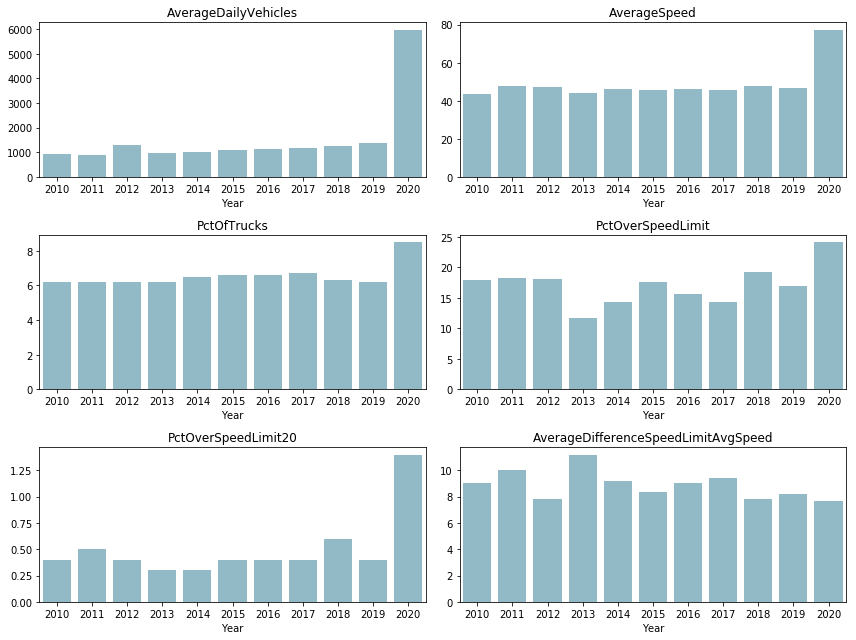

In [35]:
#Plot the median yearly value of some interesting variables
fig = plt.figure(figsize=(12,9))
for i in range(len(vars_to_plot)):
    fig.add_subplot(3, 2, i+1)
    df = traffic_data.groupby('Year')[vars_to_plot[i]].median()
    sns.barplot(df.keys(), df.values, color = "#88bdcf")
    plt.title(vars_to_plot[i])
    plt.tight_layout()
    
plt.show()

Considering the years between 2010 and 2019, the variables take stable values.

For 5 out of 6 variables, the median for 2020 is unexpectedly higher than the medians in the previous years. For instance, the `AverageDailyVehicles` and the `AverageSpeed` variables take relatively stable values throughout the years, but register a peak in 2020. In the cells below, we will focus on those two variables and check if this is due to data errors (i.e. irreasonably high numbers recorded in 2020) or if the entire distribution in 2020 is shifted towards higher values and the average reflects that distribution.

##### Average Speed

In [36]:
#Check the maximum average speed recorded in the last 4 years
for i in [2017,2018,2019,2020]:
    print("Maximum average speed registered in {}: {}".format(i,traffic_data[traffic_data.Year == i].AverageSpeed.max()))

Maximum average speed registered in 2017: 90.4
Maximum average speed registered in 2018: 114.3
Maximum average speed registered in 2019: 115.9
Maximum average speed registered in 2020: 120.5


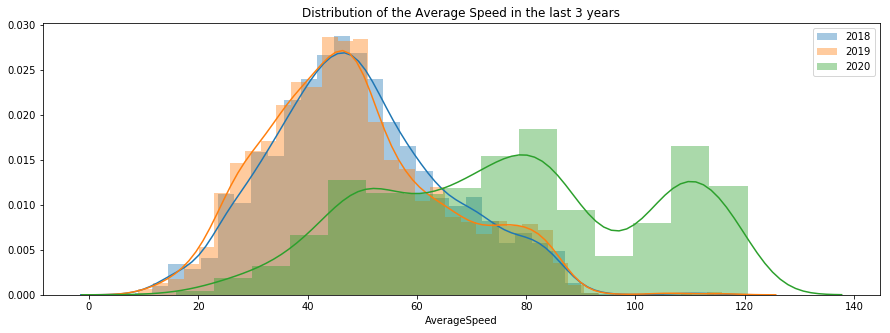

In [37]:
#Plot the distribution of the average speed in the last 3 years
plt.figure(figsize=(15,5))
for i in [2018,2019,2020]:
    sns.distplot(traffic_data[traffic_data.Year == i]["AverageSpeed"], label= i)
    plt.title("Distribution of the Average Speed in the last 3 years")
    plt.legend()

##### Number of Vehicles

In [38]:
#Checking the maximum number of vehicles recorded in the last 4 years
for i in [2017,2018,2019,2020]:
    print("Maximum numbers of vehicles registered in {}: {}".format(i,traffic_data[traffic_data.Year == i].AverageDailyVehicles.max()))

Maximum numbers of vehicles registered in 2017: 33729.0
Maximum numbers of vehicles registered in 2018: 101195.0
Maximum numbers of vehicles registered in 2019: 116145.0
Maximum numbers of vehicles registered in 2020: 134915.0


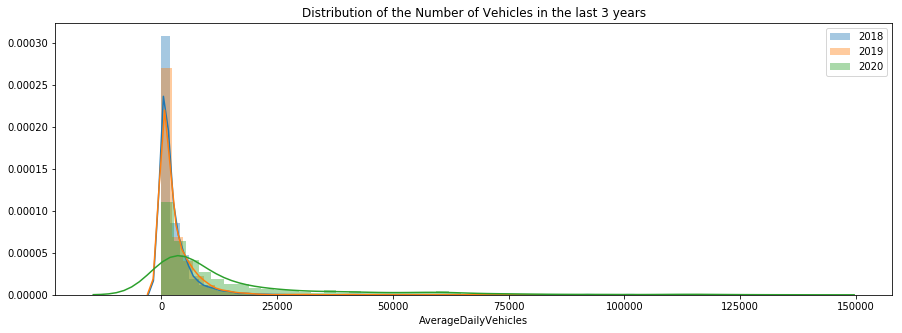

In [39]:
#Plotting the distribution of the average number of daily vehicles in the last 3 years
plt.figure(figsize=(15,5))
for i in [2018,2019,2020]:
    sns.distplot(traffic_data[traffic_data.Year == i]["AverageDailyVehicles"], label= i)
    plt.title("Distribution of the Number of Vehicles in the last 3 years")
    plt.legend()

As it can be seen, both for the `AverageDailyVehicles` and the `AverageSpeed` variables, the peaks in 2020 does not seem to be due to irreasonably high values. Instead, the peak might be due to different types of streets being measured. Indeed, for instance, if more measurements in 2020 were performed in highways, the resulting average speed and number of vehicles would be higher. 

We can verify this hypothesis by comparing the `SpeedLimit` variable throughout the years, which gives us an indication about the types of roads where the measurements have been performed.

##### Speed Limit

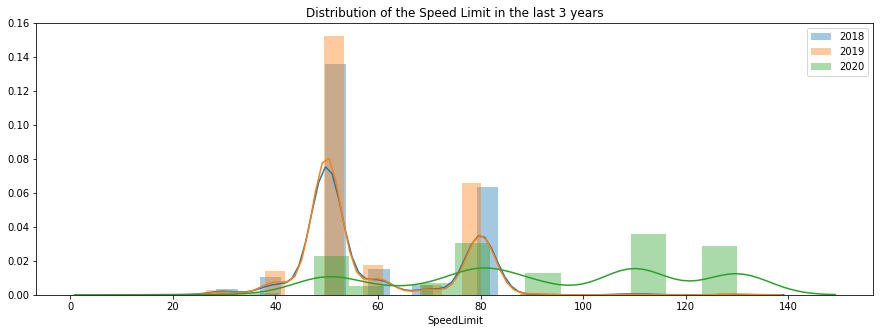

In [40]:
#Plot the distribution of the speed limit in the last 3 years
plt.figure(figsize=(15,5))
for i in [2018,2019,2020]:
    sns.distplot(traffic_data[traffic_data.Year == i]["SpeedLimit"], label= i)
    plt.title("Distribution of the Speed Limit in the last 3 years")
    plt.legend()

While in the previous years the measurements have been performed in roads that have a speed limit lower than 80km/h, in 2020 a substantial fraction of measurements has been performed in high-speed roads. 
Therefore, the main increase in speed might be driven by a difference in the sample of roads.

To test that, we plot the median value of some variables throughout the years, by only considering urban roads (`SpeedLimit` lower than 51km/h). 

##### Temporal trends in urban roads

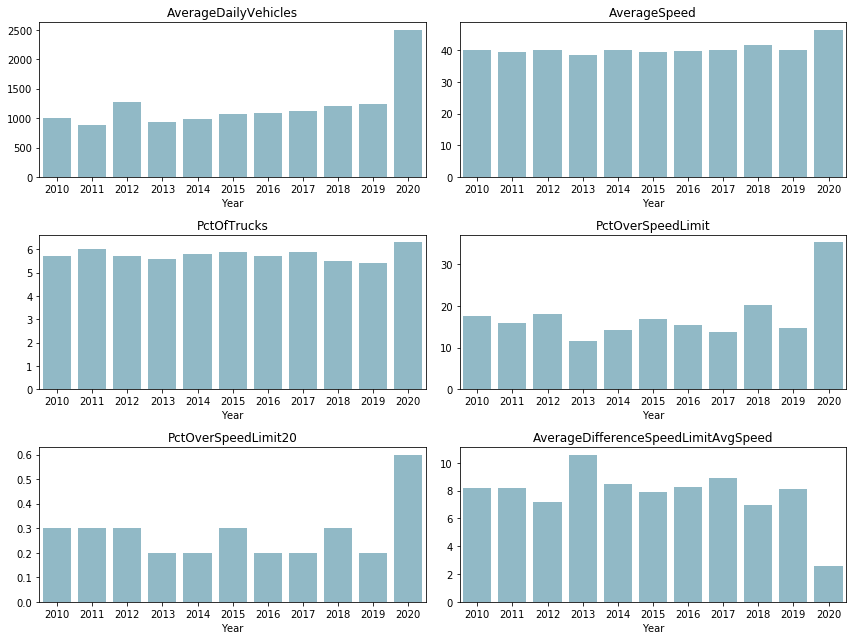

In [41]:
fig = plt.figure(figsize=(12,9))
for i in range(len(vars_to_plot)):
    fig.add_subplot(3, 2, i+1)
    df = traffic_data[traffic_data.SpeedLimit<51].groupby('Year')[vars_to_plot[i]].median()
    sns.barplot(df.keys(), df.values, color = "#88bdcf")
    plt.title(vars_to_plot[i])
    plt.tight_layout()
    
plt.show()

For some variables (`AverageSpeed`, `PctOfTrucks`), the high 2020 median value is, to a great extent, explained by the higher number of high-speed roads been measured. Indeed, when only considering the urban roads, the 2020 median is closer to the one from the previous years.

However, for the other variables (e.g. `AverageDailyVehicles` and `PctOverSpeedLimit`), even when considering only urban roads, the median value registered in 2020 is considerably higher than the one registered in the previous years. A reason for this might be that the measurements have been performed in different (more trafficated) roads, within the urban category, compared to the previous years.

#### Comparison among municipalities
We then explore some traffic patterns, by comparing the values taken by some variables in the different Danish municipalities:
- What municipalities register a higher/lower number of vehicles (`AverageDailyVehicles`)?
- What municipalities register an increase/decreas in the number of vehicles in July, compared to a standard working day (`JulyWeekdaysRatio`)?

In [42]:
#Configure GeoPandas
dk = gpd.read_file('./dataset/denmark-municipalities.geojson')
dk = dk.rename(columns={"name": "MunicipalityName"})
dk.MunicipalityName = dk.MunicipalityName.str.replace(" Kommune", "")
dk.MunicipalityName = dk.MunicipalityName.str.replace("Københavns", "København")
dk.MunicipalityName = dk.MunicipalityName.str.replace("Bornholms Regionskommune", "Bornholm")
#dk = dk[dk.MunicipalityName != "Bornholms Regionskommune"]

##### Number of vehicles

In [43]:
#Calculate average for AverageDailyVehicles for municipality
df = traffic_data.groupby('MunicipalityName').AverageDailyVehicles.mean().sort_values(ascending = False)
df.head(10)

MunicipalityName
Brøndby          44147.419355
Gladsaxe         25643.755556
Høje-Taastrup    21827.531250
Aarhus           16186.283333
Slagelse         15978.976190
Vallensbæk       12544.422222
Greve            11542.834783
Køge             11171.364641
Rebild           10799.609756
Herlev            7642.311111
Name: AverageDailyVehicles, dtype: float64

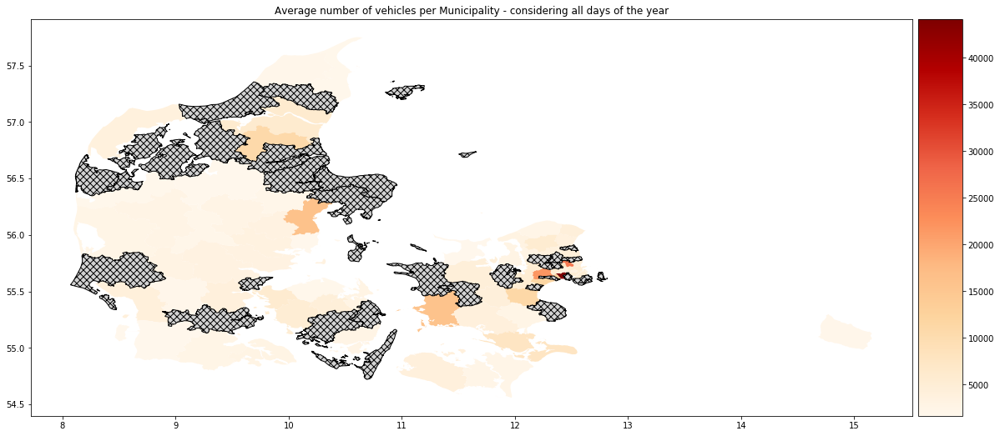

In [44]:
#Display the average number of vehicles per Municipality in a map
merged = pd.merge(dk, pd.DataFrame(df).reset_index(), how="outer")
fig, ax = plt.subplots(1,1, figsize=(20,10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
ax.set_title(f"Average number of vehicles per Municipality - considering all days of the year")
merged.plot(column="AverageDailyVehicles",
            ax=ax,
            legend=True,
            cax=cax,
            cmap='OrRd',
            missing_kwds={
            "color": "lightgrey",
            "edgecolor": "black",
            "hatch": "xxx",
            "label": "Missing values",
            })

The municipalities with highest average daily number of vehicles are _Brøndby, Gladsaxe and Høje-Taastrup_. This does not surprise given the proximity to Copenhagen and high industry/business present in that area. _Aarhus_ is also in the top 10, again not surprising given it being a big city. 

An interesting fact is that _Slagelse_ has also a very high average value, this could be due to its position close to the border towards Fyn and the presence of the Great Belt Bridge, so this could be the result of many commuters driving by or trucks transporting goods.

##### Number of vehicles in July vs a working day

In [45]:
df = (traffic_data.groupby('MunicipalityName').DailyJulyTraffic.mean() / traffic_data.groupby('MunicipalityName').AverageWeekdayDailyVehicles.mean()).sort_values(ascending = False)
df.head(10)

MunicipalityName
Odsherred        1.269833
Vordingborg      1.073189
Frederikshavn    1.064219
Rebild           1.063473
Bornholm         1.060047
Lolland          1.039421
Thisted          0.994785
Gribskov         0.978452
Billund          0.974658
Slagelse         0.974221
dtype: float64

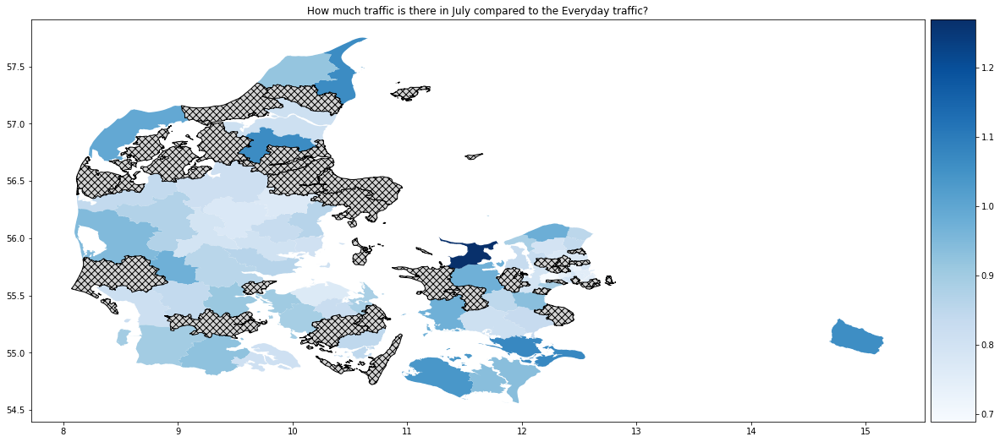

In [46]:
merged = pd.merge(dk, pd.DataFrame(df, columns={"JulyEveryDayRatio"}).reset_index(), how="outer")
fig, ax = plt.subplots(1,1, figsize=(20,10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
ax.set_title(f"How much traffic is there in July compared to the Everyday traffic?")
merged.plot(column="JulyEveryDayRatio",
            ax=ax,
            legend=True,
            cax=cax,
            cmap='Blues',
            missing_kwds={
            "color": "lightgrey",
            "edgecolor": "black",
            "hatch": "xxx",
            "label": "Missing values",
            })

Some municipalities (values <1) experience a drop in traffic in July, some (values >1) experience an increase in traffic in July.

Unsurprisingly the municipalities experiencing an increase in average daily vehicles are the ones close to the coast and known as holiday places: _ Odsherred, Bornholm, Frederikshavn, Gribskov, Thisted_. Other such as _Slagelse, Rebild, Aabenraa_ may indicate the increase affects also places close to regional and national borders, as people going on holidays drive by these municipalities. 

_Aalborg_ could be expected to experience an increase as well since it is on the way from Rebild to the northern holiday places such as Frederikshavn and Hjørring, but this is not the case. This could be due to the fact that we are plotting the ratio between everyday traffic and the one in July. Aalborg is a big city and during July experiences a decrease compared to everyday even though it is traveled by turists driving north. 

#### How does the driving behavior change in the different types of roads?

It is interesting to explore whether the behavior of Danes changes in the different types of roads. We can classify the roads based on the `SpeedLimit` values. Firstly, we look at the number of observations per `SpeedLimit` values.

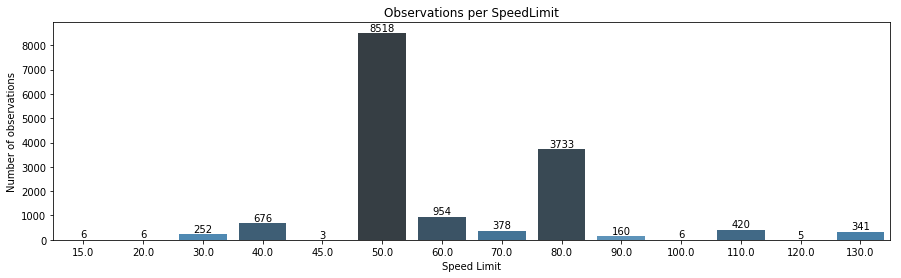

In [47]:
plt.figure(figsize=(15,4))
df=traffic_data.groupby('SpeedLimit').FID.count().reset_index()

pal = sns.color_palette("Blues_d", len(df.FID))
rank = df.FID.argsort().argsort() 
g=sns.barplot(df.SpeedLimit, df.FID, palette=np.array(pal[::-1])[rank])

for p in g.patches:
     g.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black')
g.set(ylabel='Number of observations', xlabel='Speed Limit')
plt.title("Observations per SpeedLimit");

plt.show()

We can see that there are 14 categories of roads (i.e. `SpeedLimit` values). The majority of the measurements has been performed in roads that have a `SpeedLimit`of either 50km/h or 80 km/h.

We now look into whether the behavior of Danes changes in the different types of roads. We remove the 5 categories that have few (<7) observations. Since most of the variables are not normally distributed, we compare the medians of the remaining 9 categories. 


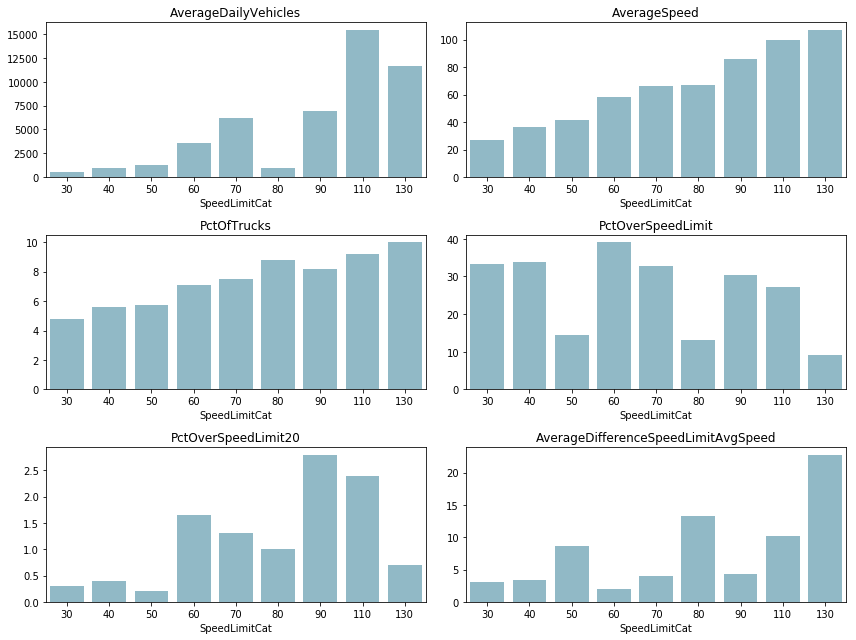

In [48]:
speedlimits = np.sort(traffic_data.SpeedLimit.unique().astype(int))
list_ordering = list(speedlimits)
a=[15,20,45,100,120]
list_ordering1 = [x for x in list_ordering if (x not in a)]
df = traffic_data[~traffic_data.SpeedLimit.isin(a)]
df["SpeedLimitCat"] = pd.Categorical(df["SpeedLimit"], categories=list_ordering1)

fig = plt.figure(figsize=(12,9))
for i in range(len(vars_to_plot)):
    fig.add_subplot(3, 2, i+1)
    df1 = df.groupby('SpeedLimitCat')[vars_to_plot[i]].median()
    sns.barplot(df1.keys(), df1.values, color = "#88bdcf")
    plt.title(vars_to_plot[i])
    plt.tight_layout()
    
plt.show()

In [49]:
#df = traffic_data.dropna(subset=['PctOfTrucks','PctOverSpeedLimit20']).reset_index(drop=True)

#for i in range(len(vars_to_plot)):
#    r, p, lower, upper = pearsonr_ci(df.SpeedLimit.values, df[vars_to_plot[i]])
#    print("Correlation between SpeedLimit and",vars_to_plot[i],":", r,"; P-value:", round(p, 3))

Clear patterns emerge from the plots above. We will discuss the patterns below and we will compute the correlation to test the relationship between the `SpeedLimit` variable and the other six variables. It is important to remember that the correlation depends on the roads that have a `SpeedLimit`of either 50km/h or 80 km/h, which represent the great majority in the data set.

- Larger roads (i.e. roads with higher `SpeedLimit`) tend to register a higher number of vehicles (`AverageDailyVehicles`) and a higher average speed (`AverageSpeed`). This is reasonable, given that larger roads are supposed to allow for higher speed limits (thus higher average speed) and to be used by a higher number of people. These trends are confirmed by statistically significant and high positive correlations:

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| SpeedLimit and AverageDailyVehicles :   | 0.404           | <0.001         |
| SpeedLimit and AverageSpeed : | 0.771           | <0.001           |

- Larger roads (i.e. roads with higher `SpeedLimit`, up to 90 km/h) tend to register a higher percentage of trucks (`PctOfTrucks`). Indeed, trucks are supposed to travel predominantly on larger roads, and sometimes they are not even allowed to travel in urban streets. This is confirmed by a positive correlation:

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| SpeedLimit and PctOfTrucks : | 0.202           | <0.001           |

- Denmark has three general speed limits (50 km/h within towns, 80 km/h outside towns, 130 km/h on motorways). Fewer people seem to drive above the speed limit (`PctOverSpeedLimit`) in the roads that those 3 standard speed limits. This might be due to the fact that those limits are well known and Danes are used to respect them. Overall, the two variables are slightly negatively correlated, suggesting that, slightly more people exceed the speed limit in smaller roads (i.e. roads with lower `SpeedLimit`):

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| SpeedLimit and PctOverSpeedLimit : | -0.081            | <0.001             |


- Larger roads tend to register a higher percentage of drivers that exceed the speed limit by more than 20km/h (`PctOverSpeedLimit20`). This might be due to the fact that 20 km/h is a relatively smaller increase when driving at a higher speed. However, this is not the case for the roads with speed limit of 130 km/h, which register a lower percentage. This can be explained by the approaching of an upper speed limit, in terms of car performances and drivers' habits. Indeed, only a fraction of cars can exceed 150km/h and people are not used to drive that fast. 
As a result of these two trends, the correlation is only slightly positive:

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| SpeedLimit and PctOverSpeedLimit20 : | 0.056            | <0.001             |

- Larger roads seem to register a bigger difference between the speed limit and the average speed (`AverageDifferenceSpeedLimitAvgSpeed`). Indeed, when the speed limit is very low (`SpeedLimit` < 50 km/h), people drive faster or only slightly slower than the speed limit. As the speed limit increases, the vehicles tend to drive more and more slow compared to the speed limit (i.e. the difference increases). This relationship is confirmed by a statistically significant and positive correlation:

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| SpeedLimit and AverageDifferenceSpeedLimitAvgSpeed  : | 0.321            | <0.001             |

Finally, in addition to investigating how the median of each type of road varies based on the other variables, we can also analyse the relationship the variables `AverageDailyVehicles`, `AverageSpeed`, `PctOverSpeedLimit`, `PctOverSpeedLimit20`, across all the road types.

In [50]:
#def hide_current_axis(*args, **kwds):
#    plt.gca().set_visible(False)#
#
#g = sns.pairplot(df, vars = ['AverageDailyVehicles', 'AverageSpeed', 
#                            'PctOverSpeedLimit', 'PctOverSpeedLimit20'], hue="SpeedLimitCat")#
#
#g.map_upper(hide_current_axis)

In [51]:
# df1 = df.dropna(subset=['AverageDailyVehicles', 'AverageSpeed', 
#                             'PctOverSpeedLimit', 'PctOverSpeedLimit20']).reset_index(drop=True)

# r, p, lower, upper = pearsonr_ci(df1.AverageSpeed.values, df1.AverageDailyVehicles)
# print("Correlation between AverageSpeed and AverageDailyVehicles",":", r,"; P-value:", round(p, 3))
# r, p, lower, upper = pearsonr_ci(df1.AverageSpeed.values, df1.PctOverSpeedLimit)
# print("Correlation between AverageSpeed and PctOverSpeedLimit",":", r,"; P-value:", round(p, 3))
# r, p, lower, upper = pearsonr_ci(df1.AverageSpeed.values, df1.PctOverSpeedLimit20)
# print("Correlation between AverageSpeed and PctOverSpeedLimit20",":", r,"; P-value:", round(p, 3))

Although, as seen above, the `PctOverSpeedLimit` is not highly correlated with the type of road (`SpeedLimit`), it is highly correlated with the `AverageSpeed`.  Larger roads do not have a higher percentage of drivers over the speed limit, but roads with higher average speed register a higher percentage of drivers over the speed limit.
This might be due to the fact that the people that exceed the speed limit cause an increase in the average speed, but do not influence the speed limit.

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| AverageSpeed  and PctOverSpeedLimit  : | 0.472            | <0.001             |

#### Which municipalities register the highest/lowest average speed?

It is interesting to investigate how the average speed varies throughout the Danish municipalities.

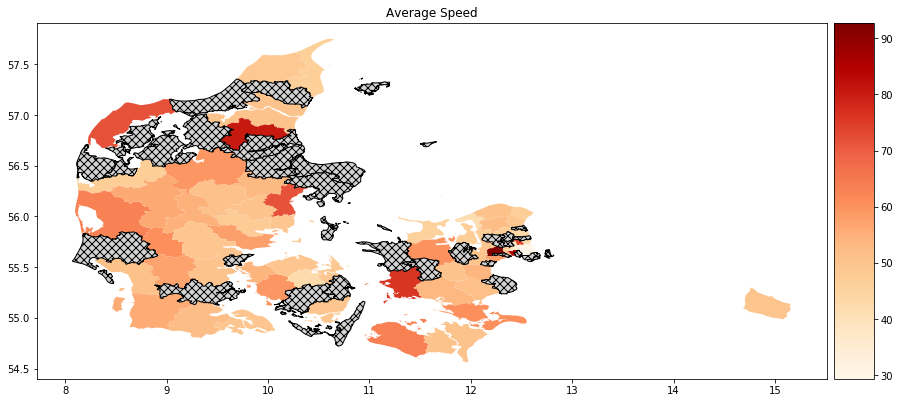

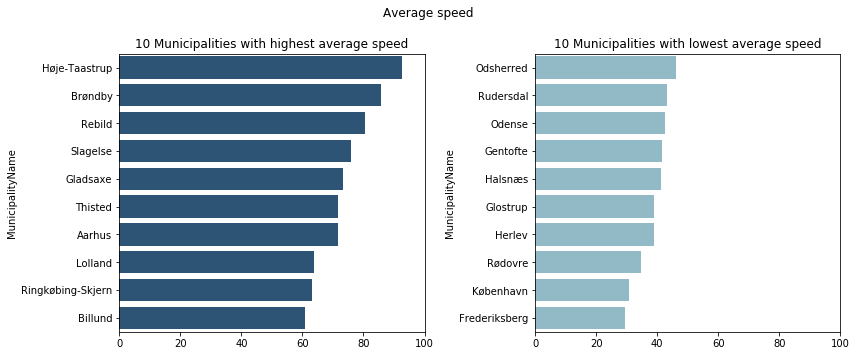

In [52]:
df = traffic_data.groupby('MunicipalityName').AverageSpeed.mean().sort_values(ascending = False)

merged = pd.merge(dk, pd.DataFrame(df).reset_index(), how="outer")
fig, ax = plt.subplots(1,1, figsize=(15,10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
ax.set_title(f"Average Speed")
merged.plot(column="AverageSpeed",
            ax=ax,
            legend=True,
            cax=cax,
            cmap='OrRd',
            missing_kwds={
            "color": "lightgrey",
            "edgecolor": "black",
            "hatch": "xxx",
            "label": "Missing values",
            })

plt.subplots(nrows=1, ncols=2, figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.title("10 Municipalities with highest average speed")
df1 = traffic_data.groupby('MunicipalityName').AverageSpeed.mean().sort_values(ascending = False).head(10)
ax = sns.barplot(df1.values, df1.keys(), order = df1.keys(), color="#215580")
ax.set(xlim=(0, 100))

plt.subplot(1, 2, 2)
plt.title("10 Municipalities with lowest average speed")
df2 = traffic_data.groupby('MunicipalityName').AverageSpeed.mean().sort_values(ascending = False).tail(10)
ax = sns.barplot(df2.values, df2.keys(), order = df2.keys(), color="#88bdcf")
ax.set(xlim=(0, 100))

plt.suptitle('Average speed')
plt.tight_layout()
plt.subplots_adjust(top=0.85)



The municipalities with the highest average speed are _Høje-Taastrup_ and *Brøndby*, which are both crossed by the [Holbækmotorvejen](https://da.wikipedia.org/wiki/Holb%C3%A6kmotorvejen), the highway that connects Copenhagen to Roskilde and Holbæk.

The municipalities with the lowest average speed are _Frederiksberg_ and *Copenhagen*, followed by the neighbouring municipalities of _Rødovre_ and *Herlev*. This might both be due to the high urban density of the area, which causes both a high number of vehicles (thus leading to a higher likelihood of congestions) and high proportion of low speed limit roads.

#### Which municipalities register the highest/lowest percentage of fast drivers?
We then explore how the percentage of people driving above the speed limit varies throughout the Danish municipalities.

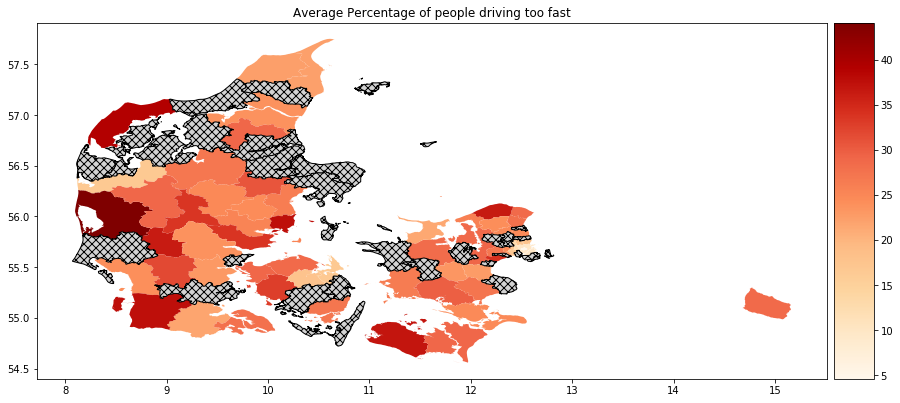

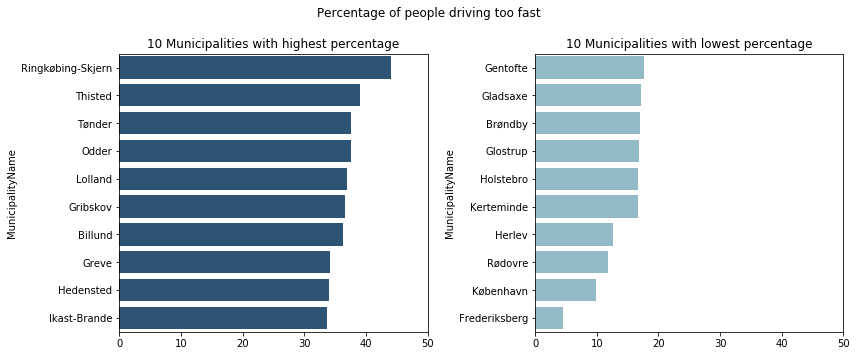

In [53]:
#Percentage of people driving too fast

df = traffic_data.groupby('MunicipalityName').PctOverSpeedLimit.mean().sort_values(ascending = False)

merged = pd.merge(dk, pd.DataFrame(df).reset_index(), how="outer")
fig, ax = plt.subplots(1,1, figsize=(15,10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
ax.set_title(f"Average Percentage of people driving too fast")
merged.plot(column="PctOverSpeedLimit",
            ax=ax,
            legend=True,
            cax=cax,
            cmap='OrRd',
            missing_kwds={
            "color": "lightgrey",
            "edgecolor": "black",
            "hatch": "xxx",
            "label": "Missing values",
            })

plt.subplots(nrows=1, ncols=2, figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.title("10 Municipalities with highest percentage")
df1 = df.head(10)
ax = sns.barplot(df1.values, df1.keys(), order = df1.keys(), color="#215580")
ax.set(xlim=(0, 50))

plt.subplot(1, 2, 2)
plt.title("10 Municipalities with lowest percentage")
df2 = df.tail(10)
ax = sns.barplot(df2.values, df2.keys(), order = df2.keys(), color="#88bdcf")
ax.set(xlim=(0, 50))

plt.suptitle('Percentage of people driving too fast')
plt.tight_layout()
plt.subplots_adjust(top=0.85)

The four municipalities with the highest percentage of people driving above the speed limit are located in *Jutland*. On average, in those four municipalities, more than 35% of the people drive too fast.
Conversely, in *Frederiksberg* and *Copenhagen* less than 10% of people drive above the speed limit.

These differences might be due to several factors, such as the number of cars, the congestions, the police checks, the types of road, the presence of urban areas or countryside.


#### Which municipalities register the highest/lowest percentage of people (among the fast drivers) driving +20km/h above the limit?
We then explore how the percentage of people driing +20km/h above the speed limit varies throughout the Danish municipalities.

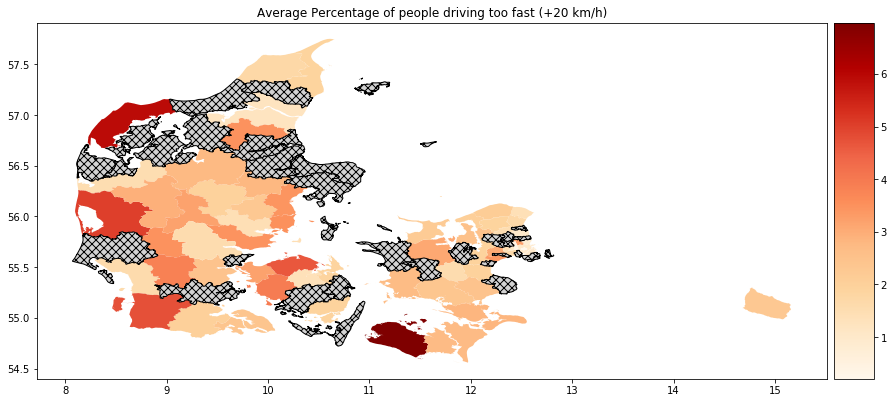

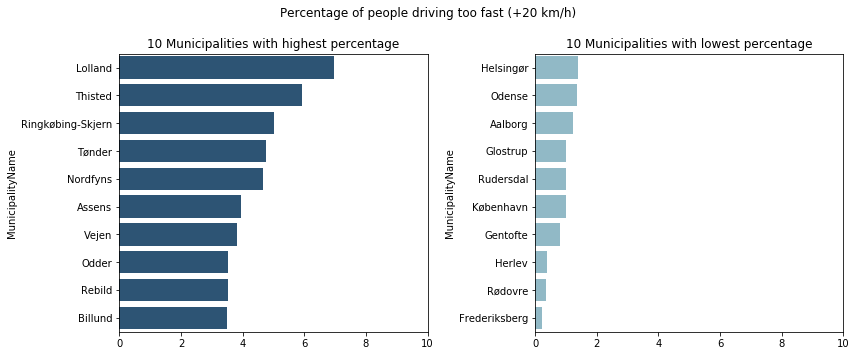

In [54]:
#Percentage of people driving too fast (+20 km/h)
df = traffic_data.groupby('MunicipalityName').PctOverSpeedLimit20.mean().sort_values(ascending = False)

merged = pd.merge(dk, pd.DataFrame(df).reset_index(), how="outer")
fig, ax = plt.subplots(1,1, figsize=(15,10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
ax.set_title(f"Average Percentage of people driving too fast (+20 km/h)")
merged.plot(column="PctOverSpeedLimit20",
            ax=ax,
            legend=True,
            cax=cax,
            cmap='OrRd',
            missing_kwds={
            "color": "lightgrey",
            "edgecolor": "black",
            "hatch": "xxx",
            "label": "Missing values",
            })

plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.title("10 Municipalities with highest percentage")
df1 = traffic_data.groupby('MunicipalityName').PctOverSpeedLimit20.mean().sort_values(ascending = False).head(10)
ax = sns.barplot(df1.values, df1.keys(), order = df1.keys(), color="#215580")
ax.set(xlim=(0, 10))

plt.subplot(1, 2, 2)
plt.title("10 Municipalities with lowest percentage")
df2 = traffic_data.groupby('MunicipalityName').PctOverSpeedLimit20.mean().sort_values(ascending = False).tail(10)
ax = sns.barplot(df2.values, df2.keys(), order = df2.keys(), color="#88bdcf")
ax.set(xlim=(0, 10))

plt.suptitle('Percentage of people driving too fast (+20 km/h)')
plt.tight_layout()
plt.subplots_adjust(top=0.85)

*Lolland* and *Thisted* have the highest percentage of people driving +20km/h above the speed limit. The previous analysis showed that this type of offence is most likely to occur in roads with speed limits higher than 50km/h but lower than 130 km/h. These municipalities might have a higher proportion of these types of streets.

Consistently with the patterns seen above for the average speed and the percentage of people driving above the speed limit, the municipalities in *Copenhagen*'s area are the ones registering the lowest percentage of people driving +20km/h above the speed limit.

#### Which roads register the highest percentage of "over the speed limit" drivers?

From our statistical description of the data features we noticed that `PctOverSpeedLimit` (the percentage of drivers over the speed limit) has a maximum value of 99.5%. This means that there is at least a road with that percentage of speed limit violations. What is peculiar about this road? Are there more?

In [55]:
highestpctoverspeed = traffic_data[traffic_data.PctOverSpeedLimit > 99]
highestpctoverspeed

,FID,Dataowner,RoadManager,RoadId,RoadPartId,RoadName,Kilometer,Meter,Location,Municipality,TypeOfVehicle,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,...,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Coordinates,Longitude,Latitude,MunicipalityName,AverageDifferenceSpeedLimitAvgSpeed,JulyWeekdaysRatio
4732,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,50,3,Sønderjyske Motorvej,76.0,500.0,Slangetælling på rampe 3 <65>,621.0,MOTORKTJ,2014,1957.0,2257.0,1820.0,...,8.8,150.0,60.0,77.5,115.9,99.5,96.0,80.0,7.7,POINT (527879.0000003118 6146584.999745438),9.440935,55.46461797720619,Kolding,-35.0,0.806380
5321,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,52,1,Esbjergmotorvejen,228.0,0.0,KOMBISNIT ved TSA 64 Kolding V (2017),621.0,MOTORKTJ,2020,9301.0,9980.0,10118.0,...,93.0,729.0,60.0,72.4,96.9,99.1,90.3,68.5,7.8,POINT (527482.0000003082 6152118.99974534),9.435204,55.514365839668294,Kolding,-24.9,1.013828
15057,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,66,0,Herningmotorvejen,9.0,750.0,øst for frakørsler ved Køverbladet,751.0,MOTORKTJ,2020,26189.0,29487.0,27438.0,...,90.2,2063.0,80.0,97.9,125.2,99.4,93.7,82.7,7.9,POINT (565856.0000010033 6224165.999744008),10.060280,56.15794683592513,Aarhus,-30.8,0.930512


An interesting aspect that all the 3 roads with the value higher than 99% share is that they are all highways (*motorvej* in Danish). However, the speed limit is lower than the one of a highway (usually greater than 100km/h): indeed the speed limits here are 80km/h and 60km/h. This can be explained by the description of the location: *frakørsler* and *rampe* indicate that this is the exit of the highway and hence explained the lower speed limit. Let's plot them on a map to get a visual confirmation.

In [56]:
map_obs = folium.Map(location=[56.2325, 10.7922], zoom_start = 7)
for index, row in highestpctoverspeed.iterrows():
    folium.Marker([row.Latitude, row.Longitude], popup=row.RoadName).add_to(map_obs)
map_obs

If we zoom on each point we can see that indeed the location is at the exit of a highway and this could explain the high number of drivers over the speed limit: the sudden change of speed limit from the highway one (over 100km/h) to a much lower one is what tricks many drivers. The high values for percentage of drivers over speed limit (also for +10km/h and +20km/h) may suggest that this change is too sudden and does not give enough visual notice or space for drivers to break and adjust their speed to the new speed limit.

By visually inspecting the road with highest value (*Sønderjyske Motorvej* in *Kolding*) with [google street view](https://www.google.com/maps/@55.4639892,9.4416129,3a,75y,321.24h,83.02t/data=!3m6!1e1!3m4!1sWmwzINIaT3ENcJ2eYp9lzA!2e0!7i13312!8i6656) we could not see a sign of a new speed limit when exiting the highway. This could hint to a lack of road signs being the cause of the high value!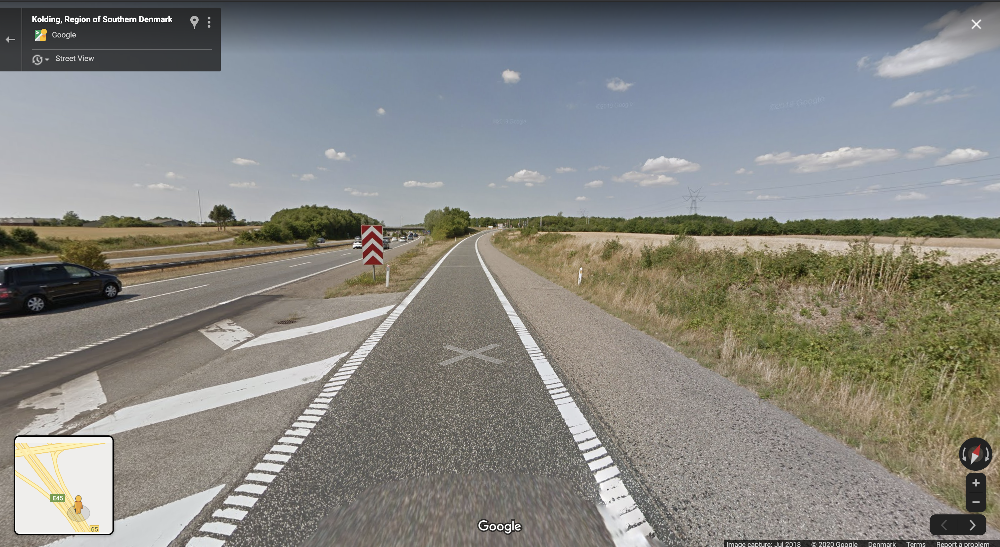

We now investigate if this is a national pattern: do highway exits present higher percentage of drivers driving over the speed limit - or are the three just analyzed an isolated case? 

We filter the observations containing "highway" in the name and having "ramp" or "exit" in their location description. We also filter on speed limits less than 100km/h to make sure that the measured spot is not at the entrance or on the highway, but at the exit of it and hence with a much lower speed limit. 

This filtering is not precise and we cannot be sure to include all the measurements of this type, but is a can be good first indicator of whether there is a possible pattern in this type of connections.

In [57]:
#Plot highway exits
roads = traffic_data[(traffic_data.RoadName.str.contains("motorvej", case=False)) 
                     & ((traffic_data.Location.str.contains("frakørsel", case=False)) 
                    | (traffic_data.Location.str.contains("rampe", case=False)))]
#Make sure it is an exit and not an entrance
roads = roads[roads.SpeedLimit < 100]
roads

,FID,Dataowner,RoadManager,RoadId,RoadPartId,RoadName,Kilometer,Meter,Location,Municipality,TypeOfVehicle,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,...,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Coordinates,Longitude,Latitude,MunicipalityName,AverageDifferenceSpeedLimitAvgSpeed,JulyWeekdaysRatio
148,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,0,0.0,40,4,Fynske Motorvej,172.0,785.0,ved frakørsel 53 ved ldv. 501,461.0,MOTORKTJ,2015,5221.0,5675.0,4840.0,...,7.0,221.0,70.0,49.0,81.9,46.0,17.5,4.0,4.2,POINT (576493.0000014836 6138679.999745573),10.207515,55.38841789958704,Odense,2.9,0.852863
2842,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,0,0.0,50,4,Sønderjyske Motorvej,23.0,0.0,ved frakørsel 71 ved ldv. 319,580.0,MOTORKTJ,2019,1441.0,1680.0,1772.0,...,81.4,271.0,80.0,73.9,95.8,68.7,30.3,8.2,18.8,POINT (523474.0000002594 6095048.999746415),9.366979,55.00175232619317,Aabenraa,-4.5,1.054762
4381,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,13,8,Hillerødmotorvejen,11.0,983.0,ved frakørsel 5 - Parallelvej Ring 4 - Vadstru...,159.0,MOTORKTJ,2020,1349.0,1697.0,1226.0,...,90.8,145.0,60.0,30.2,49.5,1.2,0.1,0.0,10.7,POINT (715978.0009624183 6184579.999757524),12.442310,55.75859992264074,Gladsaxe,18.7,0.722451
4732,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,50,3,Sønderjyske Motorvej,76.0,500.0,Slangetælling på rampe 3 <65>,621.0,MOTORKTJ,2014,1957.0,2257.0,1820.0,...,8.8,150.0,60.0,77.5,115.9,99.5,96.0,80.0,7.7,POINT (527879.0000003118 6146584.999745438),9.440935,55.46461797720619,Kolding,-35.0,0.806380
7666,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,14,3,Helsingørmotorvejen,36.0,850.0,Frakørsel til Lyngbyvej,157.0,MOTORKTJ,2020,2372.0,2757.0,1946.0,...,92.9,NaN,80.0,70.4,94.7,56.8,23.0,6.1,NaN,POINT (720901.0011260674 6184389.99976095),12.520456,55.75467537494904,Gentofte,-1.6,0.705840
8119,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,40,3,Fynske Motorvej,172.0,485.0,ved frakørsel 53 ved ldv. 501,461.0,MOTORKTJ,2015,1896.0,2228.0,1757.0,...,8.0,80.0,70.0,58.0,80.9,48.3,16.5,3.8,4.2,POINT (576927.0000015119 6138607.99974557),10.214345,55.38770323320428,Odense,0.5,0.788600
8120,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,40,5,Fynske Motorvej,172.0,465.0,ved frakørsel 53 ved ldv. 501,461.0,MOTORKTJ,2015,5521.0,6191.0,5114.0,...,8.0,233.0,70.0,71.5,92.4,89.7,53.6,19.2,4.2,POINT (576839.0000015064 6138681.999745564),10.212976,55.38838182109768,Odense,-12.3,0.826038
8121,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,40,6,Fynske Motorvej,172.0,695.0,ved frakørsel 53 ved ldv. 501,461.0,MOTORKTJ,2015,2613.0,3019.0,2421.0,...,8.0,216.0,70.0,56.3,74.8,28.3,8.2,3.6,8.3,POINT (576696.0000014992 6138544.999745572),10.210682,55.38717340172707,Odense,4.0,0.801921
9153,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,64,8,Midtjyske Motorvej,12.0,800.0,KOMBISNIT Frakørsel fra vest (2013),766.0,MOTORKTJ,2020,4852.0,5210.0,5278.0,...,93.0,408.0,90.0,85.3,119.8,75.9,57.4,32.3,8.4,POINT (531020.0000003504 6187530.999744683),9.495232,55.832334061913436,Hedensted,-13.0,1.013052
9420,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,64,3,Midtjyske Motorvej,13.0,700.0,Frakørsel fra Horsens til Tørringvej (2013),630.0,MOTORKTJ,2020,607.0,655.0,660.0,...,93.0,31.0,90.0,77.6,99.8,43.9,14.5,3.9,5.1,POINT (530120.0000003405 6187571.9997446835),9.480869,55.832759434443425,Vejle,0.9,1.007634


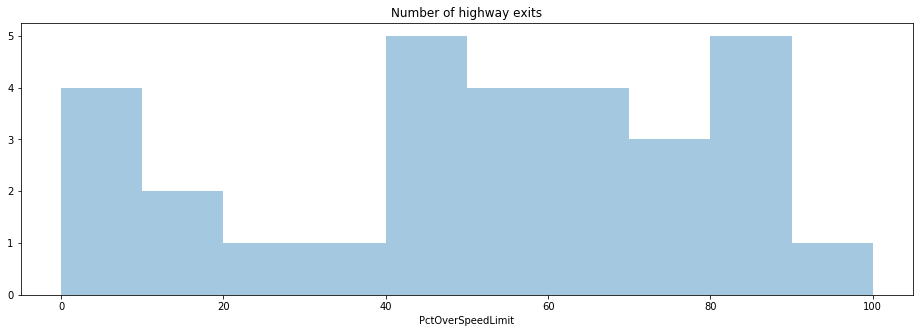

In [58]:
plt.figure(figsize=(16,5))
plt.title("Number of highway exits")
ax = sns.distplot(roads.PctOverSpeedLimit,bins=[0,10,20,30,40,50,60,70,80,90,100],kde=False)

There seems to be a general trend affecting highway exits. 

Indeed the median for `PctOverSpeedLimit` over all roads is 17.5% whereas it is **59.9%** for the selected **highway exists**.

In [59]:
roads.PctOverSpeedLimit.median()

59.9

In [60]:
traffic_data.PctOverSpeedLimit.median()

17.5

## 2B. Socioeconomic data set

In order to explain the variation in the driving behavior among municipalities, we introduce a socioeconomic data set.
The following data set contains socioeconomic factors (*nøgletal* in Danish) for all the Danish municipalities through the years from 2010 to 2020. The data set has been obtained by selecting a subset of all the available factors [here](http://noegletal.dk/noegletal/).

### i. Data loading and cleaning

In [61]:
url = 'https://raw.githubusercontent.com/IncioMan/socialdata/master/FinalProject/dataset/kommunedata_processed.csv'
kommune_data = pd.read_csv(url, encoding = "ISO-8859-1")
kommune_data

,KommuneNr,IndicatorType,Year,Value,KommuneName
0,101,Indbyggertal 1. januar,2010,528208.0,Københavns Kommune
1,101,Indbyggertal 1. januar,2011,539542.0,Københavns Kommune
2,101,Indbyggertal 1. januar,2012,549050.0,Københavns Kommune
3,101,Indbyggertal 1. januar,2013,559440.0,Københavns Kommune
4,101,Indbyggertal 1. januar,2014,569557.0,Københavns Kommune
...,...,...,...,...,...
19399,860,Gennemsnitlig skolestørrelse,2016,880.0,Hjørring Kommune
19400,860,Gennemsnitlig skolestørrelse,2017,850.0,Hjørring Kommune
19401,860,Gennemsnitlig skolestørrelse,2018,820.0,Hjørring Kommune
19402,860,Gennemsnitlig skolestørrelse,2019,804.0,Hjørring Kommune


In [62]:
kommune_data.shape

(19404, 5)

The data set contains 19404 observations and 5 features. One of these features is `IndicatorType`, which specifies the type of socioeconomic factor reported in the observation. 18 types of factors are include in the data set.

#### Available socioeconomic factors
We get an overview of the 18 socioeconomic factors, by translating them into English and reporting a brief description of each factor.

In [63]:
english_factors = {'Indbyggertal 1. januar':'Population_size_1_January',
'Andel 0-17-årige': 'Percentage_0-17-years',
'Andel 18-66-årige': 'Percentage_18-66-years',
'Andel 65+-årige': 'Percentage_65+-years',
'Befolkningstæthed (indb/km2)': "Population_density_(inhab/km2)",
'Andel udpendlere': "Percentage_outgoing_commuters",
'Andel indpendlere': "Percentage_ingoing_commuters",
'Andel 25-64-årige med videregående uddannelse': "Percentage_adults_higher_education",
'Fuldtidsledige pr. 100 17-64/66-årige': "Unemployed_pr100_17-64/66-years",
'Statsborgere fra vestlige lande pr. 10.000 indb.': "Citizens_western_countries_pr10000",
'Statsborgere fra ikke-vestlige lande pr. 10.000 indb.': "Citizens_not_western_countries_pr10000",
'Anmeldte tyverier/indbrud pr. 1.000 indb.': "Reported_thefts_break-ins_pr_1000",
'Anmeldte voldsforbrydelser pr. 1.000 indb.': "Reported_violent_crimes_pr_1000",
'Socioøkonomisk indeks': "Socioeconomic_factor",
'Udg. til byudvikling, bolig og miljø pr. indb.': "Expenses_city_development_pr_citizen",
'Udg. til transport og infrastruktur pr. indb.': "Expenses_transportation_pr_citizen",
'Antal folkeskoler': "Number_of_primary_schools",
'Gennemsnitlig skolestørrelse': "Average_size_schools"}

In [64]:
#convert names to the English versions
kommune_data = kommune_data.replace({"IndicatorType": english_factors})

In [65]:
kommune_data.IndicatorType.unique()

array(['Population_size_1_January', 'Percentage_0-17-years',
       'Percentage_18-66-years', 'Percentage_65+-years',
       'Population_density_(inhab/km2)', 'Percentage_outgoing_commuters',
       'Percentage_ingoing_commuters',
       'Percentage_adults_higher_education',
       'Unemployed_pr100_17-64/66-years',
       'Citizens_western_countries_pr10000',
       'Citizens_not_western_countries_pr10000',
       'Reported_thefts_break-ins_pr_1000',
       'Reported_violent_crimes_pr_1000', 'Socioeconomic_factor',
       'Expenses_city_development_pr_citizen',
       'Expenses_transportation_pr_citizen', 'Number_of_primary_schools',
       'Average_size_schools'], dtype=object)

A summary of the available factors along with a brief description for each of them:

| Socioeconomic factor                                                           | Description |
|------------------------------------------------------------------|:-------------|
| Population_size_1_January                                        | Number of inhabitants in the municipality on the 1st of January.          |
| Percentage_0-17-years                                            |  Number of 0-17 year olds as a percentage of the number of inhabitants in the municipality on the 1st of January     |
| Percentage_18-66-years                                           |  Number of 18-66 year olds as a percentage of the number of inhabitants in the municipality on the 1st of January           |
| Percentage_65+-years                                             |  Number of inhabitants aged 65 and over as a percentage of the number of inhabitants in the municipality on the 1st of January.           |
| Population_density_(inhab/km2)                                    | Number of inhabitants per km2 on the 1st of January           |
| Percentage_outgoing_commuters                                    |   Number of people employed in another municipality as a percentage of the number of employed people residing in the municipality per 1st of January.          |
| Percentage_ingoing_commuters                                     |   Number of people with a place of work in the municipality, but domiciled in another municipality as a percentage of people with a place of work in the municipality per year on the 1st of January.          |
| Percentage_adults_higher_education                     |   Number of 25-64 year olds with a higher education in relation to the total number of 25-64 year olds in the municipality.          |
| Unemployed_pr100_17-64/66-years                                  |  Average number of full-time unemployed in the municipality per 100 17-64 year olds. Unemployment is defined as gross unemployment, which is defined as the sum of the registered (net) unemployed and those who are at the same time considered to be job ready. The population is calculated on the 1st of January 1 of the year.           |
| Citizens_western_countries_pr10000                          |  Number of people with citizenship from Western countries per 10,000 inhabitants per 1st of January.  Western countries include EU countries plus Andorra, Iceland, Liechtenstein, Monaco, Norway, San Marino, Switzerland, Vatican City, Canada, USA, Australia and New Zealand.  |
| Citizens_not_western_countries_pr10000                      |   Number of people with citizenship from non-western countries per 10,000 inhabitants per 1st of January.          |
| Reported_thefts_break-ins_pr_1000                                |   Number of police reported thefts, including car theft, motorcycle / moped and bicycles as well as burglary. 1,000 inhabitants per 1st of January. The violations include burglary in the bank, shops, villas, apartments, holiday homes, garages, etc., car theft, boat, shop theft and other thefts, as well as theft and use theft of registered vehicles, mopeds and bicycles.          |
| Reported_violent_crimes_pr_1000                                  |     Number of police reported crimes against private individuals per 1,000 inhabitants per 1st of January.        |
| Socioeconomic_factor                                             |  The key figure measures the municipality's relative expenditure needs in relation to other municipalities on the basis of a number of socio-economic criteria. There are criteria such as 'Number of 20-59 year-olds without employment' and 'Number of psychiatric patients'. The precise definition can be found in the Ministry of Social Affairs and the Ministry's publication 'Municipal Equalization and General Grants 2008', page 40. A value above 1 means that the municipality has a greater need for expenditure relative to the average of the municipalities, while a value lower than 1 means a lower spending needs relative to the average.     |
| Expenses_city_development_pr_citizen |   Net operating expenses (DKK) in main account that covers the areas of land supply, real estate, recreation areas, leisure facilities, cemeteries, nature protection, waterways, environmental protection, etc. and emergency preparedness.         |
| Expenses_transportation_pr_citizen         |   Net operating expenses (DKK) per inhabitant in the account that covers the areas of municipal roads, public transport and ports. Data up to and including 2018 are accounting figures, while information thereafter is budget figures. The population is calculated per. January 1 of the year.     |
| Number_of_primary_schools                                        |    The number of primary schools is calculated as the average for the two school years included in the calendar year. For the past school year, this is an expected number.          |
| Average_size_schools                                             |   The number of normal class pupils from kindergarten to 10th grade divided by the number of primary schools calculated as the average for the two school years included in the calendar year. For the past school year, this is an expected number.    |

#### NaN Values

The dataset does not present Nan values.

In [66]:
kommune_data.isna().sum()

KommuneNr        0
IndicatorType    0
Year             0
Value            0
KommuneName      0
dtype: int64

#### Number of municipalities
As expected, we have data for all the 98 danish municipalities.

In [67]:
len(kommune_data.KommuneNr.unique())

98

In [68]:
len(kommune_data.KommuneName.unique())

98

#### Errors and outliers
We analyse the summary statistics and address potential errors.

In [69]:
kommune_data.describe()

,KommuneNr,Year,Value
count,19404.000000,19404.000000,19404.000000
mean,462.173469,2015.000000,3477.919301
std,235.351491,3.162359,20811.227583
min,101.000000,2010.000000,-525.000000
25%,240.000000,2012.000000,14.000000
50%,435.000000,2015.000000,44.700000
75%,706.000000,2018.000000,351.000000
max,860.000000,2020.000000,632340.000000


From this statistical summary we can notice that the `Year` feature does not present outliers. All the values for `Year` lie in the range 2010-2020 as expected. For analyzing the statistical summaries for the factors, we need to group by `IndicatorType`.

In [70]:
kommune_data.groupby(kommune_data.IndicatorType)["Value"].describe()

,count,mean,std,min,25%,50%,75%,max
IndicatorType,,,,,,,,
Average_size_schools,1078.0,455.296846,284.421433,-1.00,302.000,409.50,590.000,2126.00
Citizens_not_western_countries_pr10000,1078.0,343.367347,197.235967,20.00,216.000,308.00,394.750,1493.00
Citizens_western_countries_pr10000,1078.0,311.810761,137.189556,108.00,208.250,284.00,378.000,1014.00
Expenses_city_development_pr_citizen,1078.0,875.750464,542.538264,-80.00,491.500,758.50,1110.500,4106.00
Expenses_transportation_pr_citizen,1078.0,1861.199443,1581.005225,-525.00,1418.250,1645.50,1910.750,20176.00
Number_of_primary_schools,1078.0,11.333488,10.450301,-1.00,4.000,9.00,15.500,60.50
Percentage_0-17-years,1078.0,21.203711,2.337273,12.50,20.000,21.50,22.700,26.90
Percentage_18-66-years,1078.0,60.967532,2.727855,51.10,59.525,60.90,62.100,73.80
Percentage_65+-years,1078.0,20.521521,4.119909,10.30,18.000,19.80,22.400,39.90


All factors present the same number of observations. We can notice that some factors have -1 as minimum value. Factors such as `Unemployed` or `Percentages` should not take negative values. It is likely that -1 is used as replacement for missing values. 

However factors such as `Expenses_for_city_development_residential_environment_pr_citizen` and `Expenses_for_transportation_and_infrastructure_pr_citizen` do have a minimum values which are not simply -1. Instead, a few observations present different negative values. 

In [71]:
kommune_data[kommune_data.IndicatorType.str.contains("Expenses") & (kommune_data.Value < 0)]

,KommuneNr,IndicatorType,Year,Value,KommuneName
15545,350,Expenses_city_development_pr_citizen,2012,-71.0,Lejre Kommune
15546,350,Expenses_city_development_pr_citizen,2013,-32.0,Lejre Kommune
15984,751,Expenses_city_development_pr_citizen,2011,-17.0,Aarhus Kommune
15985,751,Expenses_city_development_pr_citizen,2012,-37.0,Aarhus Kommune
16064,787,Expenses_city_development_pr_citizen,2014,-80.0,Thisted Kommune
17046,741,Expenses_transportation_pr_citizen,2017,-525.0,Samsø Kommune


Investigating further the description of these factors, it turns out that these represent netto figures. Even though it is not common, it may be that these municipalities have earned more than what they have invested in those sectors that year. We therefore decided to keep these values as they do not seem to represent mistakes in the data. 

In [72]:
#Remove negative values for variables not referring to expenses
kommune_data = kommune_data[(kommune_data.IndicatorType.str.contains("Expenses") | (kommune_data.Value > 0))]

In [73]:
kommune_data.shape

(18322, 5)

By removing the obervations with negative values, we reduce the dataset by around 1000 observations.
We investigate how the remaining observations are distribuited per year.

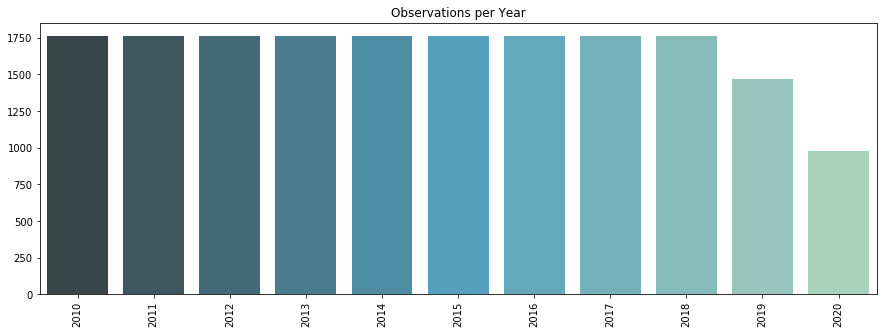

In [74]:
plt.figure(figsize=(15,5))
plt.title("Observations per Year")
df = kommune_data.Year.value_counts()
ax = sns.barplot(df.keys(), df.values, order=df.keys().sort_values(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

It can be observed that the data set is complete for the year 2010-2018, while some factors are missing for the years 2009-2020. All the observations we removed were related to the last two years. This is reasonable, given that some factors cannot be computed before the end of the year and that retreiving some information takes time.

### ii. Summary statistics and variable distribution
Considering the clean data set, we display the summary statistics and then investigate how the variables are distributed.

In [75]:
kommune_data.groupby(kommune_data.IndicatorType)["Value"].describe()

,count,mean,std,min,25%,50%,75%,max
IndicatorType,,,,,,,,
Average_size_schools,980.0,500.926531,257.035458,141.00,335.750,434.00,606.250,2126.00
Citizens_not_western_countries_pr10000,1078.0,343.367347,197.235967,20.00,216.000,308.00,394.750,1493.00
Citizens_western_countries_pr10000,1078.0,311.810761,137.189556,108.00,208.250,284.00,378.000,1014.00
Expenses_city_development_pr_citizen,1078.0,875.750464,542.538264,-80.00,491.500,758.50,1110.500,4106.00
Expenses_transportation_pr_citizen,1078.0,1861.199443,1581.005225,-525.00,1418.250,1645.50,1910.750,20176.00
Number_of_primary_schools,980.0,12.566837,10.168141,1.00,6.000,10.00,16.125,60.50
Percentage_0-17-years,1078.0,21.203711,2.337273,12.50,20.000,21.50,22.700,26.90
Percentage_18-66-years,1078.0,60.967532,2.727855,51.10,59.525,60.90,62.100,73.80
Percentage_65+-years,1078.0,20.521521,4.119909,10.30,18.000,19.80,22.400,39.90


The summary statistics table reveals that some municipalities subseed or exceed the interquartile range. However, the values seem reasonable and some differences among the municipalities is expected.

#### Distribution of each socioeconomic factor

For each socioeconomic factor, we compute the average value (throughout the years) for each of the 98 municipalities. We then plot the factor distribution.

It is interesting to notice that most of the factors exhibit a right-skewed distribution. This is caused by a majority of municipalities taking similar values, and a few municipalities taking higher values. For instance, we expect *Copenhagen* to be an outlier for some socioeconomic factors (e.g. population size).

In [76]:
#Rename Municipality names
kommune_data.rename(columns={'KommuneName':'MunicipalityName'}, inplace=True)
kommune_data["MunicipalityName"] = kommune_data.MunicipalityName.str.replace(' Kommune' ,'')
kommune_data["MunicipalityName"] = kommune_data["MunicipalityName"].replace('Københavns' ,'København')
kommune_data["MunicipalityName"] = kommune_data["MunicipalityName"].replace('Bornholms' ,'Bornholm')

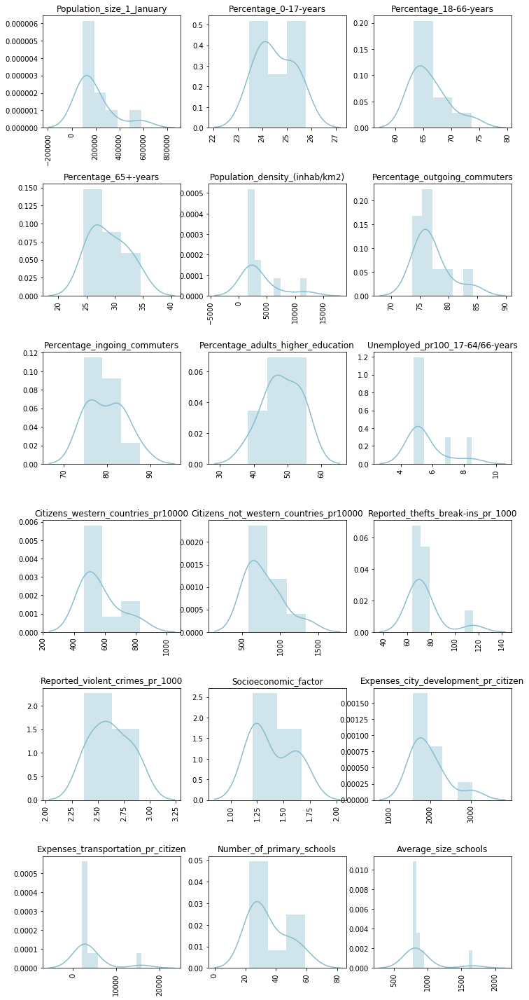

In [77]:
factors = kommune_data.IndicatorType.unique()

fig = plt.figure(figsize=(12,25))
for i in range(len(factors)):
    fig.add_subplot(6, 3, i+1)
    df1 = kommune_data[kommune_data.IndicatorType == factors[i]].groupby(['MunicipalityName']).Value.mean().sort_values(ascending = False).head(10)
    ax = sns.distplot(df1.values, color = "#88bdcf")
    plt.setp(ax.get_xticklabels(), rotation=90);
    plt.title(factors[i])
    plt.subplots_adjust(hspace=0.5)
    plt.xlabel(None)
        
plt.show()

#### Municipalities with the highest average scores for the 18 factors
For each factor, we investigate which municipalities register the highest average values, thus representing the right tail of the distribution. To do so, for each factor, we plot the 10 municipalities with the highest average value.

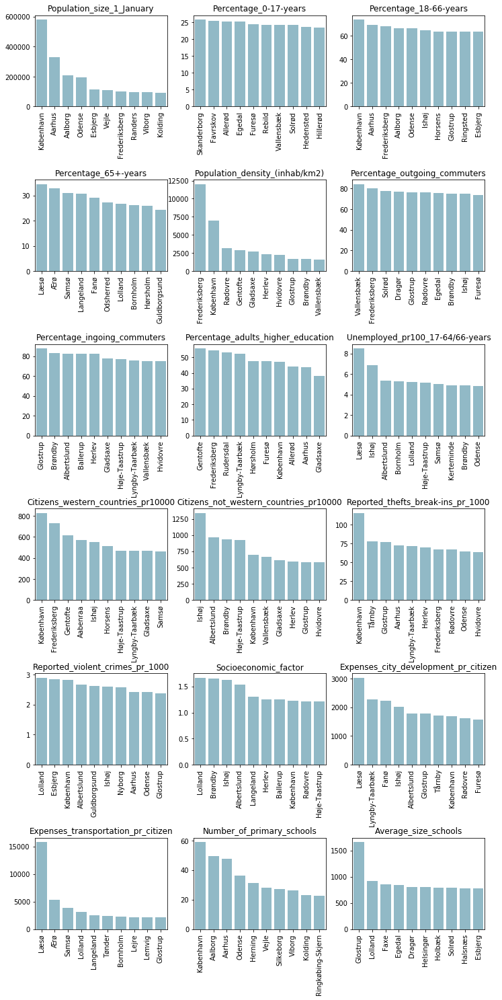

In [78]:
fig = plt.figure(figsize=(12,25))
for i in range(len(factors)):
    fig.add_subplot(6, 3, i+1)
    df1 = kommune_data[kommune_data.IndicatorType == factors[i]].groupby('MunicipalityName').Value.mean().sort_values(ascending = False).head(10)
    ax = sns.barplot(df1.keys(), df1.values, color = "#88bdcf")
    plt.setp(ax.get_xticklabels(), rotation=90);
    plt.title(factors[i])
    plt.subplots_adjust(hspace=0.8)
    plt.xlabel(None)
        
plt.show()

As expected, *Copenhagen* is among the 10 municipalities with the highest average value for 9 factors out of 18. Compared to the average municipality, the Danish capital has greater population size, density, number of schools, but also a greater proportion of adults (18-65 years old), of adults with higher education, of citizens from western countries. It also has a greater percentage of thefts and violent crimes, and higher expenses for city development.

*Læso* also stands out, registering a high percentage of elderly people (65+ years old), higher unemployment rates, and higher expenses both for city development and transportation. However, some of the socioeconomic factor values might be driven by the fact that it is a very small island, with an extremely small number of inhabitants.

#### Correlations among socioeconomic variables

We also investigate the correlation of the socioeconomic variables, as we expect that some of them might have a high correlation.

In [79]:
#Restructure the socioeconomic data set to have one variable per factor 
socioeconomic_data2 = pd.DataFrame(kommune_data[kommune_data.IndicatorType == factors[0]].groupby(['MunicipalityName']).Value.mean())
socioeconomic_data2.rename(columns={'Value':factors[0]}, inplace=True)
for i in factors[1:]:
    socioeconomic_data2[i] = pd.DataFrame(kommune_data[kommune_data.IndicatorType == i].groupby(['MunicipalityName']).Value.mean())

In [80]:
corr_matrix = np.round(socioeconomic_data2.corr(),1) 
mask = np.zeros_like(corr_matrix, dtype=np.bool)
mask[np.triu_indices_from(mask)]= True

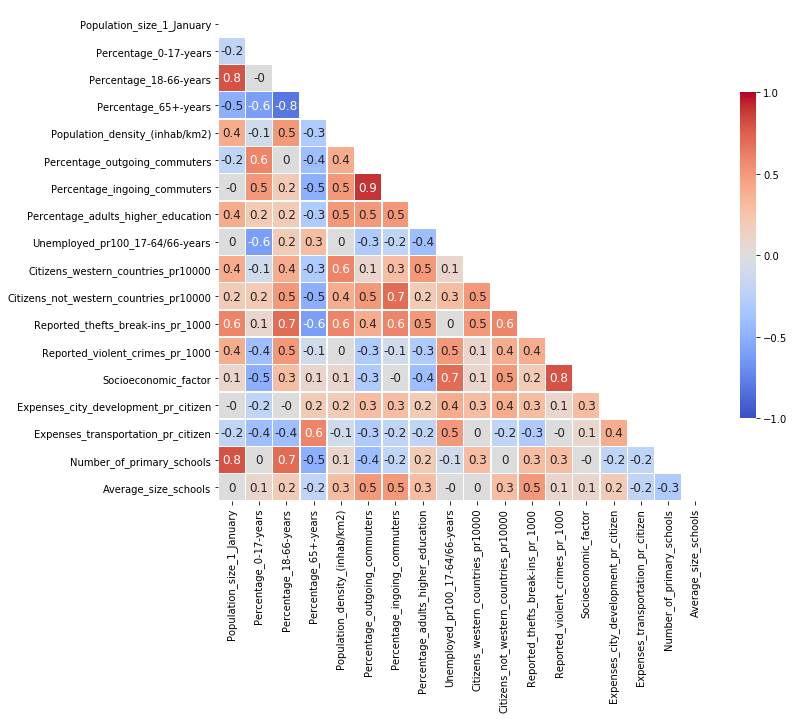

In [81]:
f, ax = plt.subplots(figsize=(11, 15)) 
heatmap = sns.heatmap(corr_matrix, 
                      mask = mask,
                      square = True,
                      linewidths = .5,
                      cmap = 'coolwarm',
                      cbar_kws = {'shrink': .4, 
                                'ticks' : [-1, -.5, 0, 0.5, 1]},
                      vmin = -1, 
                      vmax = 1,
                      annot = True,
                      annot_kws = {'size': 12})
#add the column names as labels
ax.set_yticklabels(corr_matrix.columns, rotation = 0)
ax.set_xticklabels(corr_matrix.columns)
sns.set_style({'xtick.bottom': True}, {'ytick.left': True})

Two interesting correlations are:
- `Percentage_outgoing_commuters` and `Percentage_ingoing_commuters`. This suggests that municipalities experience either a high or low number of commuters in both directions. Both indicators seem to reflect an overall intensity of movement for business reasons.
- `Socioeconomic_factor` and `Reported_violent_crimes`. Both indicators seem to suggest that some areas are more critical from a social point of view, and thus might need more support from the governement.

## 3. Data Analysis
### 3A. Merging the traffic data and socioeconomic data

In [82]:
#socioeconomic_data2.shape

In [83]:
#Restructure the traffic data set to compute the average per municipality
traffic_data_by_municipality = traffic_data.groupby(['MunicipalityName'])
traffic_data2 = pd.DataFrame(traffic_data_by_municipality.AverageSpeed.mean())
traffic_data2["AverageDailyVehicles"] = pd.DataFrame(traffic_data_by_municipality.AverageDailyVehicles.mean())
traffic_data2["PctOverSpeedLimit"] = pd.DataFrame(traffic_data_by_municipality.PctOverSpeedLimit.mean())
traffic_data2["PctOverSpeedLimit20"] = pd.DataFrame(traffic_data_by_municipality.PctOverSpeedLimit20.mean())

In [84]:
#traffic_data2.shape

In [85]:
#Merge traffic data and socioeconomic data
combined_data = pd.merge(traffic_data2, socioeconomic_data2, left_index=True, right_index=True , how='inner')
#combined_data.shape

In [86]:
#combined_data.head()

### 3B. Relation between driving behavior and socioeconomic data
We wish to predict the expected driving behavior (`AverageSpeed` and `PctOverSpeedLimit`) for a certain value of the socioeconomic variables. Before doing that, we explore the relation betwen the two groups of variables, by plotting some scatterplots and printing the correlation coefficients (together with the p-value).

#### Relation between `AverageSpeed` and the socioeconomic factors

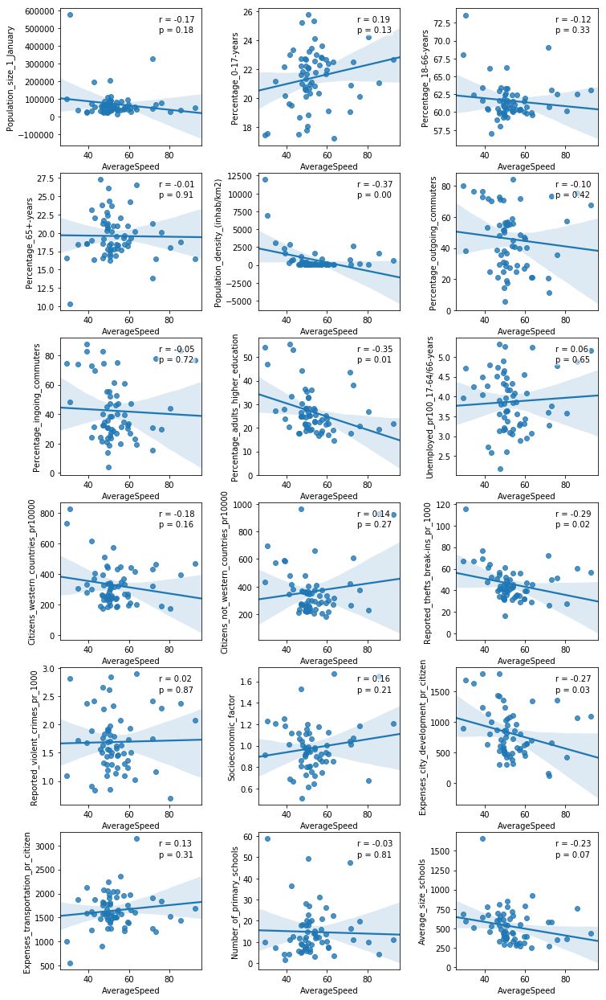

In [87]:
df = combined_data

col = traffic_data2.columns[0]#average speed
cols = traffic_data2.columns
df2 = df.drop(cols,axis=1)
df2.index = df[col]

fig = plt.figure(figsize=(12,22))
for i in range(len(socioeconomic_data2.columns)):
    fig.add_subplot(6, 3, i+1)
    ax = sns.regplot(x=df[col], y = df2[df2.columns[i]], ci = 95)
    bbox_props = dict(boxstyle="round,pad=0.2", fc="white", ec='white', lw=0, alpha=0.6)
    ax.annotate("r = {:.2f}".format(pearsonr_ci(x=df[col], y = df2[df2.columns[i]])[0]), xy=(.7, .9), xycoords=ax.transAxes, bbox=bbox_props)
    ax.annotate("p = {:.2f}".format(pearsonr_ci(x=df[col], y = df2[df2.columns[i]])[1]), xy=(.7, .82), xycoords=ax.transAxes, bbox=bbox_props)
    plt.ylabel(df2.columns[i])
    plt.subplots_adjust(wspace=0.4)
       
plt.show()

Some interesting relations emerge from the scatterplots and are confirmed by the correlation coefficients. 
`Average speed` is negatively associated with:
- population density
- percentage of adults with higher education
- reported thefts and break-ins
- expenses for city development

`Average speed` should be affected by the types of roads. This might explain why it is lower in municipalities that have a higher population density. The other variables might also be representative of a urban area, which is expected to have more low-speed roads.

#### Relation between `PctOverSpeedLimit` and the socioeconomic factors

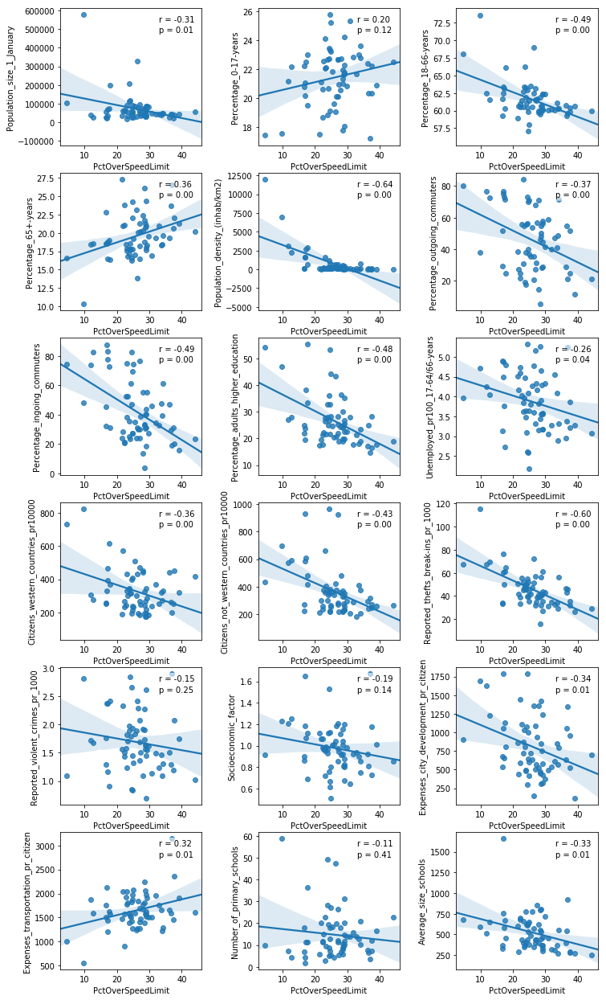

In [88]:
df = combined_data

col = traffic_data2.columns[2]#Percentage over speed limit
cols = traffic_data2.columns
df2 = df.drop(cols,axis=1)
df2.index = df[col]

fig = plt.figure(figsize=(12,22))
for i in range(len(socioeconomic_data2.columns)):
    fig.add_subplot(6, 3, i+1)
    ax = sns.regplot(x=df[col], y = df2[df2.columns[i]], ci = 95 )
    bbox_props = dict(boxstyle="round,pad=0.2", fc="white", ec='white', lw=0, alpha=0.6)
    ax.annotate("r = {:.2f}".format(pearsonr_ci(x=df[col], y = df2[df2.columns[i]])[0]), xy=(.7, .9), xycoords=ax.transAxes, bbox=bbox_props)
    ax.annotate("p = {:.2f}".format(pearsonr_ci(x=df[col], y = df2[df2.columns[i]])[1]), xy=(.7, .82), xycoords=ax.transAxes, bbox=bbox_props)
    plt.ylabel(df2.columns[i])
    plt.subplots_adjust(wspace=0.4)
    
plt.show()

Some interesting relations emerge from the scatterplots and are confirmed by the correlation coefficients. 
`PctOverSpeedLimit` is, among others, negatively associated with:
- percentage of adults
- percentage of outgoing and ingoing commuters
- population density
- percentage of adults with higher education
- percentage of citiziens from western or nonwestern countries
- expenses for city development

These factors seem to characterize an urban area, where more adults live and work (i.e. commute), people tend to have a higher education, more immigrants are present and the population density is higher. Compared to a rural area, such an urban area might cause speed limit violations to be more difficult (because of the number of traffic lights and the amount of traffic) and more dangerous (because of the presence of more people close to the street and the number of cameras and speed controls). Overall, it might cause the `PctOverSpeedLimit` to be lower.

### 3E. KNN: predicting speed limit violations in unmeasured areas

In this section we build a model for prediction of the driving pattern in different neighbourhoods throughout Denmark. We choose to focus on the variable `PctOverSpeedLimit` as the responce, as we find this the most interesting to predict. To predict this, we will use a KNN model that is based on the neighbouring roads driving speeds.

In [89]:
# pip install global_land_mask
# pip install mpl_toolkits

# If you get the error: FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\Jonas\\Anaconda3\\envs\\geonum\\Library\\share\\proj\\epsg' 
# Use the following code below.  Navigate to your own folder where the epsg data is found

import os
os.environ['PROJ_LIB'] = r'C:\Users\Bruger\Anaconda3\pkgs\proj4-5.2.0-ha925a31_1\Library\share' 

from shapely.geometry import Point
from shapely.geometry.polygon import Polygon
from global_land_mask import globe
from sklearn.model_selection import RandomizedSearchCV

Let's start by generating the points of neighbourhoods we wish to predict across Denmark.

In [90]:
# Generate Latitude and Longitude points for prediction and visualisation.
longridnobh = np.linspace(7.5018, 12.5018, 90)
latgridnobh = np.linspace(53.2639 , 57.7639, 90)
longridbh = np.linspace(14.50, 15.50, 30)
latgridbh = np.linspace(55.0 , 56.0, 30)
longrid = np.concatenate([longridnobh,longridbh])
latgrid = np.concatenate([latgridnobh,latgridbh])

In [91]:
# Remove points that are in the water
latland = []
lonland = []
for i in range(len(longridnobh)):
    for j in range(len(latgridnobh)):
        
          if not globe.is_ocean(latgridnobh[j],longridnobh[i]):
            latland.append(latgridnobh[j])
            lonland.append(longridnobh[i])
                                       
for i in range(len(longridbh)):
    for j in range(len(latgridbh)):
        
          if not globe.is_ocean(latgridbh[j],longridbh[i]):
            latland.append(latgridbh[j])
            lonland.append(longridbh[i])    

In [92]:
denmark = folium.Map([56.2639,9.5018], zoom_start=7)
# Show the points for prediction
for i in range(0,len(lonland)):

        point = folium.CircleMarker(location=[latland[i],lonland[i]],
                                radius=0.8,
                                weight=2).add_to(denmark)
denmark.add_child(point)

It is seen that there are some left-over points in Sweden and Germany which needs to be removed. Additionally Amager is recognized as ocean by global_land_mask, which is fixed by adding a few points manually for Amager.

In [93]:
# Add some points for Amager for visualisation purposes since it is registered as ocean by global_land_mask
latland.append(55.6108)
lonland.append(12.6052)
latland.append(55.65108)
lonland.append(12.6052)
latland.append(55.5708)
lonland.append(12.6052)
latland.append(55.6108)
lonland.append(12.6452)
latland.append(55.6108)
lonland.append(12.5652)

Use the https://dawa.aws.dk/ API to get Municipality data (and border-data for Denmark), and remove points which are in Germany and Sweden. The API is time-consuming so load the pickled data instead if they are available.

In [94]:
'''
import requests
lonland_clean = []
latland_clean = []
denmark = folium.Map([56.2639,9.5018], zoom_start=7)

list_of_response = []
# scatter plot
for i in range(0,len(lonland)):
    
    url = "https://dawa.aws.dk/kommuner/reverse?x={}&y={}".format(lonland[i],latland[i])
    response = requests.get(url)
    if response.status_code == 200:
        list_of_response.append(response.json())
        lonland_clean.append(lonland[i])
        latland_clean.append(latland[i])
        print(i)     
        #point = folium.Marker(location=[latland[i],lonland[i]],
        #                        radius=0.8,
        #                        weight=2).add_to(denmark)
        
#denmark.add_child(point)

# Save data for reuse
import pickle
with open('list_of_response.pkl', 'wb') as f:
    pickle.dump(list_of_response, f)
with open('lonland_clean.pkl', 'wb') as f:
    pickle.dump(lonland_clean, f)
with open('latland_clean.pkl', 'wb') as f:
    pickle.dump(latland_clean, f)
'''
# Load pickles
file1 = open('latland_clean.pkl', 'rb')
latland_clean = pickle.load(file1)
file2 = open('lonland_clean.pkl', 'rb')
lonland_clean = pickle.load(file2)
file3 = open('list_of_response.pkl', 'rb')
list_of_response = pickle.load(file3)

Let's view the data which is gonna be used for the prediction model.

In [95]:
denmark = folium.Map([56.2639,9.5018], zoom_start=7)
# scatter plot
for i in range(0,len(latland_clean)):
  
   
        point = folium.CircleMarker(location=[latland_clean[i],lonland_clean[i]],
                                radius=0.8,
                                weight=2).add_to(denmark)
denmark.add_child(point)

The data points look reasonably spread across of Denmark with none in Sweden or Germany. Each point will thus be a prediction to indicate how the speeding patterns are in the given neighbourhood. 

Let's combine the Latitude Longitude of the different points.

In [96]:
# Grab kommune data for points
list_of_response[0]
point_kommune_names = []
for element in list_of_response:
    point_kommune_names.append(element["navn"])
# Save data in a dataframe for KNN model 
knndata = pd.DataFrame(columns=["Latitude","Longitude","MunicipalityName"])
knndata["Latitude"] = latland_clean
knndata["Longitude"] = lonland_clean
knndata["MunicipalityName"] = point_kommune_names

Xdata = traffic_data[["Longitude","Latitude"]]
ydata = pd.to_numeric(traffic_data["PctOverSpeedLimit"], downcast='float')

Using the sklearn tool RandomizedSearchCV we can try different hyperparameters for the model. In this case we use the default setting given by RandomizedSearchCV and KNeighborsRegressor, except varying the number of K neighbours. To get a better estimate of the model performance and reduce overfitting we choose to use 5-fold cross validation. 

In [97]:
# Define the parameter grid and fit the model
random_grid = {'n_neighbors': [1,2,3,5,10,20,50,100]}

knn = KNeighborsRegressor()
knn_random = RandomizedSearchCV(estimator = knn, param_distributions = random_grid, n_iter = 10, cv = 5, verbose=2, random_state=42, n_jobs = -1)
models = knn_random.fit(Xdata, ydata)
best_knn_model = models.best_estimator_

Fitting 5 folds for each of 8 candidates, totalling 40 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  40 out of  40 | elapsed:    3.4s finished


The results are accessed and analysed by calling the *cv_results_* and *best_estimator_* variable generated by the cross validation method.

In [98]:
models.best_estimator_

KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=50, p=2,
                    weights='uniform')

In [99]:
knn_random.cv_results_

{'mean_fit_time': array([0.02398467, 0.02858124, 0.02258477, 0.02498336, 0.0275804 ,
        0.02498341, 0.02378454, 0.02358451]),
 'std_fit_time': array([0.00363069, 0.00355344, 0.0018532 , 0.0057579 , 0.00770572,
        0.00493798, 0.00330873, 0.00475516]),
 'mean_score_time': array([0.01219239, 0.01259279, 0.01479149, 0.01499109, 0.01878982,
        0.02318621, 0.04517221, 0.08654752]),
 'std_score_time': array([0.00159968, 0.00135521, 0.00247973, 0.00303054, 0.00411555,
        0.00239851, 0.00594396, 0.01425423]),
 'param_n_neighbors': masked_array(data=[1, 2, 3, 5, 10, 20, 50, 100],
              mask=[False, False, False, False, False, False, False, False],
        fill_value='?',
             dtype=object),
 'params': [{'n_neighbors': 1},
  {'n_neighbors': 2},
  {'n_neighbors': 3},
  {'n_neighbors': 5},
  {'n_neighbors': 10},
  {'n_neighbors': 20},
  {'n_neighbors': 50},
  {'n_neighbors': 100}],
 'split0_test_score': array([-0.55603092, -0.19909638, -0.1133322 , -0.02181175,  

We see that the optimal amount of neighbours is 50 and the mean squared error for the prediction model is 0.0631. In comparison, since the scoring metric for the KNN is the R^2 value, a baseline model predicting the points using the mean value of the predictions would have an R^2 value of 0, indicating that the model perfomance is not so great. This is somewhat to be expected, as the model is fairly simple and only reliant on the driving patterns at the nearby roads. If more data for the  roads that weren't recorded would be gathered, it would be possible to build a more complext model with a (supposedly) improvement in performance.

A visualisation of the prediction values across denmark is seen below, a darker color indicates that the roads are more prone to being driven above the speed limit.

In [100]:
preds = best_knn_model.predict(knndata[["Longitude","Latitude"]])
colorscale = branca.colormap.linear.RdPu_09.scale(min(preds)+10, max(preds)-10)
colorscale.caption = 'Percentage over speeding limit'
#denmark.add_child(colorscale)

denmark2 = folium.Map([56.2639,9.5018], zoom_start=7)
# scatter plot
for i in range(0,len(knndata)):

        #pred = best_knn_model.predict(knndata[["Latitude", "Longitude"]].iloc[i].values)
        point = folium.CircleMarker(location=[knndata["Latitude"].iloc[i], knndata["Longitude"].iloc[i]],
                                radius=0.8,
                                weight=2,color = colorscale(preds[i])).add_to(denmark2)
denmark2.add_child(colorscale)

From the plot it is evident that some regions have higher speeding than others, specifically looking a western and southern Jutland, there are regions with higher speeding. It is also interesting to see that in places such as Copenhagen and Odense the speeding drivers are much fewer. It should however be noted that since the models performance is not great, there is uncertainty in the predictions presented.

Feel free to look at roads in your neighbourhood! You can scroll to zoom in and out, and drag the map to move around.

### 3D. Linear regression: predicting speed limit violations based on socioeconomic factors

As seen previously when analysing the correlations between the traffic data and the socioeconomic factors, the socioeconmic factors for the municipalities may be valuable in prediciting the driving patterns across Denmark. In this section a Linear Regression model is used to explain the relation between the  `PctOverSpeedLimit` variable and the correlated socioeconomic factors. Ultimately values for the municipalities which were left out due to too few observations are predicted.

Let's grab the combined data for the factors and the traffic data which had aggregated the traffic data across all years and municipalities.

In [101]:
combined_data.head()

,AverageSpeed,AverageDailyVehicles,PctOverSpeedLimit,PctOverSpeedLimit20,Population_size_1_January,Percentage_0-17-years,Percentage_18-66-years,Percentage_65+-years,Population_density_(inhab/km2),Percentage_outgoing_commuters,Percentage_ingoing_commuters,Percentage_adults_higher_education,Unemployed_pr100_17-64/66-years,Citizens_western_countries_pr10000,Citizens_not_western_countries_pr10000,Reported_thefts_break-ins_pr_1000,Reported_violent_crimes_pr_1000,Socioeconomic_factor,Expenses_city_development_pr_citizen,Expenses_transportation_pr_citizen,Number_of_primary_schools,Average_size_schools
MunicipalityName,,,,,,,,,,,,,,,,,,,,,,
Aabenraa,52.402558,2527.713953,21.838837,2.036471,59201.090909,21.136364,60.663636,20.972727,63.090909,27.455556,28.655556,19.40,4.177778,570.545455,301.000000,41.41,2.33,1.061818,436.181818,2050.181818,20.15,295.1
Aalborg,50.782062,6043.296907,23.826392,1.231959,207546.909091,18.863636,66.254545,17.118182,182.454545,19.288889,25.266667,32.99,4.477778,344.090909,300.545455,49.60,1.97,0.967273,811.090909,1394.909091,49.50,373.0
Aarhus,71.604167,16186.283333,26.320833,3.445000,327585.727273,19.045455,69.036364,13.854545,700.272727,20.622222,31.022222,43.55,3.600000,433.000000,421.727273,72.20,2.42,1.042727,152.818182,1264.090909,47.45,577.3
Albertslund,47.278862,5730.325203,24.497561,1.426829,27807.181818,22.718182,62.981818,16.563636,1197.545455,73.044444,82.633333,26.71,5.322222,397.636364,965.636364,54.60,2.66,1.532727,1790.454545,1828.818182,4.95,609.0
Allerød,47.533036,3940.285714,24.929464,1.529464,24643.181818,25.227273,58.036364,19.190909,365.545455,71.277778,74.611111,44.29,2.188889,232.727273,268.181818,44.09,1.32,0.511818,598.090909,2073.181818,5.30,652.5


We start by removing the variables which were found to have no significant correlation with the `PctOverSpeedLimit` variable. Then we use backwards feature selection from the sklearn module in combination with 3-fold cross validation to reduce the amount of independent variables in the linear regression model. This is done to deal with multicolinearity in the model and reduce overfitting.

In [102]:
# Select X and y data and fit the model
Xdata = combined_data.drop(columns=["PctOverSpeedLimit","AverageSpeed", "AverageDailyVehicles", "PctOverSpeedLimit20"]) # drop y variable and other traffic-related data
Xdata = Xdata.drop(columns=["Percentage_0-17-years","Reported_violent_crimes_pr_1000","Socioeconomic_factor","Number_of_primary_schools"])
ydata = combined_data["PctOverSpeedLimit"]
# Create the RFE object and compute a cross-validated score.
linreg = LinearRegression()
rfecv = RFECV(estimator=linreg, step=1, cv=KFold(3))
rfecv.fit(Xdata, ydata)

RFECV(cv=KFold(n_splits=3, random_state=None, shuffle=False),
      estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
                                 normalize=False),
      min_features_to_select=1, n_jobs=None, scoring=None, step=1, verbose=0)

Let's have a look at the results from the model selection and cross validation

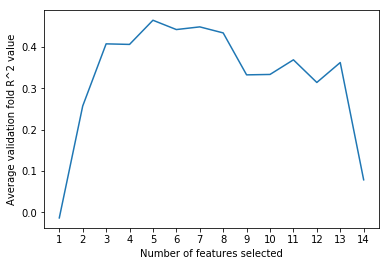

In [103]:
# Plot number of features VS. cross-validation scores
plt.figure()
plt.xlabel("Number of features selected")
plt.ylabel("Average validation fold R^2 value")
plt.xticks(np.arange(0, 19, step=1))
plt.plot(range(1, len(rfecv.grid_scores_) + 1), rfecv.grid_scores_)
plt.show()

We notice that the optimal number of features in the model is 5, with an R^2 value of 0.47. The R^2 value is not very high, indicating that the models performance is somewhat lacking, nonetheless it is possible to describe some of the variation in the `PctOverSpeedLimit` for municipalities using ther socio-economic factors. Further improvements to the model could be made if more data was available, unfortunately there is a limited amount of municipalities in Denmark - but perhaps addition of other independent variables would contribute to a higher explanatory power. Danes driving behaviour is a very intricate phenomenon to predict and naturally it is not expected to have an exact prediction of this solely based on socio-economic factors. Still we can get a decent estimate using the found model compared to a baseline of mean-prediction of the `PctOverSpeedLimit` values, which would have an R^2 of 0.

Below are the models chosen variables and coefficients printed.

| Variable                                     | Coefficient |
|----------------------------------------------|-------------|
| Intercept                                    | 119       |
| Percentage_18-66-years                       | -0.957        |
| Percentage_65+-years                         | -0.0448        |
| Percentage_ingoing_commuters                 | -0.134     |
| Percentage_25-64-years_with_higher_education | -0.300      |
| Unemployed_pr100_17-64/66-years              | -3.10       |

It is seen that all coefficients are negative, which is due to the high intercept. Naturally it is never the case that the `PctOverSpeedLimit` would be 119%, but it is also never the case in the data that there is a zero percentage of younger and elderly people. It is seen that the coefficient for the unemployment rate is high, indicating that the more employment there is in a municipality, the less people tend to drive over the speed limit. It is important to not confuse this correlation with causation, as it could very well be the case that unemployment (and other variabels) are merely correlated with the `PctOverSpeedLimit`, but not to say that they are the cause of people driving above the speeding limit in a given municipality.

A residual analysis for the model is seen below. First we look at the normality assumption of the residuals using a qq-plot.

In [104]:
predictions = rfecv.estimator_.predict(Xdata[Xdata.columns.values[rfecv.support_]])
residuals = predictions - ydata

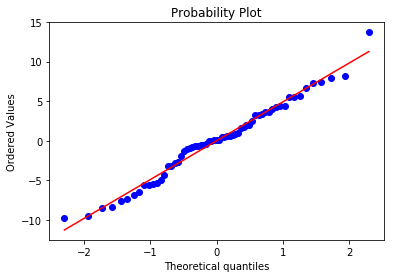

In [105]:
import scipy
scipy.stats.probplot(residuals, dist="norm", plot=plt)
plt.show()

It is noted that the majority of the residuals fit the normal distribution nicely, inciating that the assumption of normality is upheld.

Next, the assumption of homoscedasticity is investigated by plotting the residuals against the fitted values.

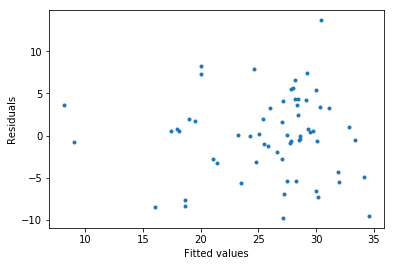

In [106]:
plt.plot(predictions,residuals,'.')
plt.xlabel("Fitted values")
plt.ylabel("Residuals")
plt.show()

We see that there is a slight tendency to higher variance in the residuals towards the higher fitted values, but since the majority of the municipalities carry values in this range, it is also expected. Judging from the plot and with this knowledge the assumption seems reasonably upheld.

Lastly the assumptions of independence of residuals is checked. The residuals are plotted against the order of observation and also against the independent variables to check for any systematic behaviour.

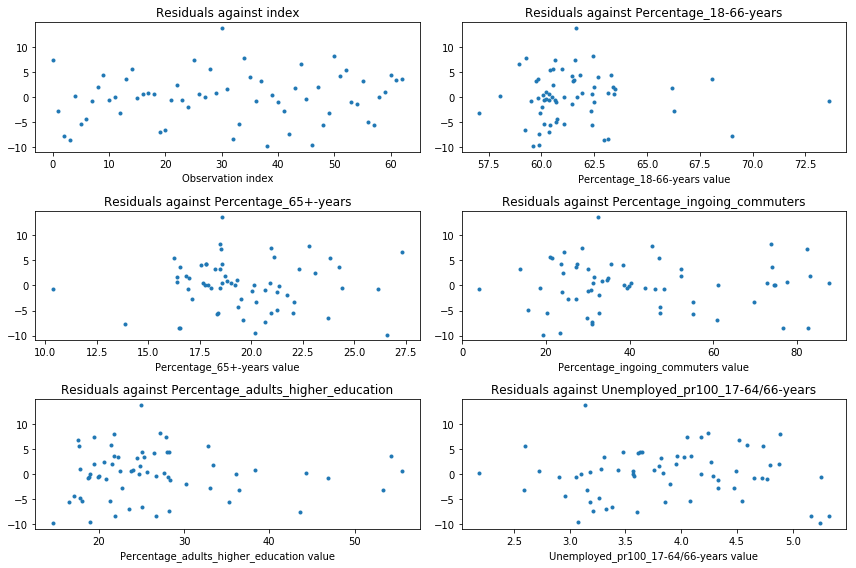

In [107]:
fig = plt.figure(figsize=(12,8))
i = 0

fig.add_subplot(3, 2, i+1)
i+=1
plt.plot(residuals.values,'.')
plt.title("Residuals against index")
plt.xlabel("Residual value")
plt.xlabel("Observation index")
plt.subplots_adjust(wspace=0.4)

for col in Xdata.columns.values[rfecv.support_]:
    
    fig.add_subplot(3, 2, i+1)
    i+=1
    plt.plot(Xdata[col],residuals,'.')
    plt.title("Residuals against " +str(col))
    plt.xlabel("Residual value")
    plt.xlabel(str(col)+" value")
    plt.subplots_adjust(wspace=0.4)
    plt.tight_layout()

Looking at the different plots it seems that there are no clear systematic behaviour to the residuals which is what was desired. From all these plots it is concluded that the residuals are independent and identically distributed.

Now `PctOverSpeedLimit` predictions for the municipalities that were previously left out due to too few traffic-observations are made using the linear regression model. These predictions are seen visualised on the webpage. Go check it out!

In [108]:
missing_municipalities = list(set(selectedmunicipalities) ^ set(list(socioeconomic_data2.index.values)))
Xdata_notselected = socioeconomic_data2[socioeconomic_data2.index.isin(missing_municipalities)][Xdata.columns.values[rfecv.support_]]
predictions_notselected = rfecv.estimator_.predict(Xdata_notselected)
predictions_notselected
Xdata_notselected_withpreds = Xdata_notselected.copy(deep=True)
Xdata_notselected_withpreds["LinregPredictions"] = predictions_notselected
Xdata_notselected_withpreds.to_csv("LinRegPredictions.csv")

## 4. Genre. Which genre of data story did you use?

We combined the features of the *annotated chart* and the *slideshow* genres.

### 4A. Which tools did you use from each of the 3 categories of Visual Narrative (Figure 7 in Segal and Heer). Why?
Across the 6 visualizations, we used the following tools from each of the 3 categories of Visual Narrative: 
- **Visual structuring**: in order to simplify the narrative experience and help orient the viewer, we used a *consistent visual platform*, by keeping the map of Denmark fixed and displaying the value taken by different variables. That also allows to establish an overview, before zooming on specific areas of the map, if needed.
- **Highlighting**: in order to direct the viewer's attention to some salient elements in the narrative, we have adopted *feature distinction* (by hilighting extreme values with lighter or darker colors) and *motion* (by introducing some information, such as the coloring of some municipalities, through animations).
- **Transition guidance**: to guide the user through the transitions, we used *animated transitions*. In this way the viewer can, for instance, keep track of a municipality in a correlation plot, when changing the displayed variable.

### 4B. Which tools did you use from each of the 3 categories of Narrative Structure (Figure 7 in Segal and Heer). Why?
Across the 6 visualizations, we used the following tools from each of the 3 categories of Narrative Structure: 
- **Ordering**: the path through the visualization is *linear*, i.e. precribed by the author. However, within each visualisation, we mainly adopted a *user-directd* path, giving the user the opportunity to select among different variables. This is aimed at balancing author-driven and reader-driven stories.
- **Interactivity**: we introduced *hover highlighting/details* (by providing details-on-demand when mousing over the map), a *selection* functionality (by allowing the user to select and inspect different variables) and *explicit tutorials*.
- **Messaging**: we used *introductory text*, *captions*, color-scheme *annotations*.

## 5. Visualizations

### Explain the visualizations you've chosen. Why are they right for the story you want to tell?

We implemented 6 visualizations, guiding the viewer from a more general exploration of the patterns in the data sets, to an explicatory analysis of the differences in the driving behavior:
- **Geographic differences in driving behavior**: A map of Denmark is displayed. The viewer can select a variable related to the driving behavior and explore how its value varies in the different Danish municipalities. The value for each municipality is communicated through color-scheme annotations. By mousing over a municipality, the viewer gets more precise information about that value. We also enabled a zoom, so the viewer can easily focus on small municipalities. Our implementation of this visualization in d3 can be found [here](https://observablehq.com/@incioman/denmark-traffic-data/2).
- **Geographic differences in socioeconomic index**: A map of Denmark is displayed. The viewer can select a socioeconomic factor and explore how its value varies in the different Danish municipalities. The value for each municipality is communicated through color-scheme annotations. By mousing over a municipality, the viewer gets more precise information about that value. We also enabled a zoom, so the viewer can easily focus on small municipalities. Our implementation of this visualization in d3 can be found [here](https://observablehq.com/@incioman/socioeconomic-indexes-of-denmark).
- **Relation between driving behavior and socioeconomic factors**: The viewer can select a driving behavior variable and a socioeconomic factor and visualize their relation in a scatterplot. Our implementation of this visualization in d3 can be found [here](https://observablehq.com/@incioman/correlation-plots-socioeconomic-data-and-traffic-data-in-d).
- **Predicting speed limit violations based on socioeconomic factors**: A linear regression model is computed and showcased through this visualization. Through some sliders, the viewer can adjust the value of the independent variables (socioeconomic factors) and visualize the impact on the predicted dependent variable (speed limit violations). This is aimed at demonstrating how a change in the socioeconomic factors is associated to a change in the speed limit violations. Our implementation of this visualization in d3 can be found [here](https://observablehq.com/@incioman/percentage-over-speed-limit-predictor-from-social-indexes).
- **Predicting speed limit violations in unmeasured municipalities (using linear regression)**: A map of Denmark is displayed. The regression model is used to predict the speed limit violations for the municipalities that did not have enough road measurements. To engage the viewer, the prediction is compiled when the viewer presses a button. Our implementation of this visualization in d3 can be found [here](https://observablehq.com/@incioman/denmark-traffic-data-predict).
- **Predicting speed limit violations in unmeasured areas (using KNN)**: A map of Denmark is displayed. A KNN model is used to predict the speed limit violations for the areas that did not have enough road measurements. This prediction is based on the geographic coordinates and allows to predict, at a more granular level, the speed limit violations for areas that do not have road measurements. By mousing over a point, the viewer gets more detailed information about the predicted value. Our implementation of this visualization in d3 can be found [here](https://observablehq.com/@incioman/mouse-over-predictions).

## 6. Discussion. Think critically about your creation
### 6A. What went well?

### 6B. What is still missing? What could be improved?, Why?

## 7. Contributions. Who did what?
The project has been carried out continuously discussing, peer reviewing and exchanging ideas with the contribution of the whole group. 

Following we list the main tasks each of us has taken a lead role on:

| Student        | Tasks                                        |
|:--------------:|:---------------------------------------------------------:|
| Jonas     | Machine Learning (KNN and Linear Regression model) |
| Alex         | Interactive visualizations (D3 and Observables) and GeoPandas visualizations |
| Alessandro   | Correlations exploration                                |
| Common tasks | Dataset statistical analysis and exploration                            |

# Appendix

### Generating data file for interactive visualizations
Most of our [interactive visualizations](https://observablehq.com/collection/@incioman/danish-driving-behavior) are based on maps of Denmark plotting data for the different municipalities. 

We here showcase how we prepared the data to be exported and used in our visualizations.

In order for this to be achieved, we export a geojson file. One row for each municipality. Each row contains a MultiPolygon representation of the municipality, that will be used to draw it on the map, along with the data to be plotted. We use geaopandas dataframe for storing municipality name and they polygon. We merge it with the dataframe containing the data to plot.

In [2]:
#Format the dataframe to plot so that it can be merged
Xdata_notselected_withpreds = Xdata_notselected_withpreds.rename( columns = {"LinregPredictions": "PctOverSpeedLimit" })
Xdata_notselected_withpreds.set_index(["MunicipalityName"], inplace=True)
#Merge predictions with real values
combined = pd.concat([traffic_data2, Xdata_notselected_withpreds])
combined = combined[['PctOverSpeedLimit']]
#Combine predictions and geopandas dataframe
combined = combined.rename_axis('MunicipalityName').reset_index()
merged = pd.merge(dk, combined, how="outer")
#Export file for observable visualization
merged.to_file("pctoverspeedlimit.geojson", driver='GeoJSON')

NameError: name 'Xdata_notselected_withpreds' is not defined

The same procedure has been followed to export data for all the visualizations showing data at municipality level on the map of Denmark